<a href="https://colab.research.google.com/github/Chetan1207/Netflix-Unsupervised-Clustering/blob/main/Netflix_Project_with_Template.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    -  Netflix movies and TV shows clustering



##### **Project Type**    - Unsupervised
##### **Contribution**    - Team
##### **Team Member 1-** Chetan Prakash
##### **Team Member 2-** Pallavi Wagh

# **Project Summary -**

This project's goal is to do a cluster analysis on a Netflix dataset in order to identify trends and group items that are similar together. Information on films, actors, directors, genres, and countries was included in the collection.

The project took a methodical approach to cluster analysis:

1. **Data Preprocessing:** To manage missing values, eliminate irrelevant columns, and convert category variables into numerical representations, the dataset was cleaned and preprocessed. Text data was also processed by eliminating stopwords and tokenizing them.
2. **Feature Extraction:** Term Frequency-Inverse Document Frequency (TF-IDF) was used to vectorize text data in order to turn textual information into numerical characteristics that could be utilised for clustering.
3. **Dimensionality Reduction:** To minimise the dimensionality of the feature space while keeping significant information, Principal Component Analysis (PCA) was used. This stage aided in successfully visualising and grouping the data.
4. **Clustering Algorithm Selection:** We explored a number of clustering techniques, including K-means and agglomerative clustering. Using assessment measures including the Davies-Bouldin Score, Calinski-Harabasz Score, and Silhouette Score, the total number of clusters was calculated. The best clustering method hyperparameters were discovered using GridSearchCV.
5. **Cluster Visualization:** Scatter plots, word clouds, and 3D plots were used to visualise the clusters. These visualisations aided in comprehending the clusters' properties and distributions.
6. **Evaluation:** The quality of the clusters was evaluated using evaluation measures such the silhouette score, Calinski-Harabasz score, and Davies-Bouldin score. These measures gave us information about the clusters' separation, compactness, and similarity.

Netflix's cluster project yielded valuable insights into its dataset, uncovering hidden patterns and grouping similar items. The analysis enabled personalized recommendations, targeted marketing, and content classification. Further refinement and exploration of algorithms, parameters, and features are needed to improve clustering performance and provide a foundation for data-driven decision making in the entertainment industry.

# **GitHub Link -**

Pallavi Wagh - https://github.com/waghpallavi/Netflix-movies-and-TV-shows-clustering.git

Chetab Prakash - https://github.com/Chetan1207/Netflix-Unsupervised-Clustering

# **Problem Statement**


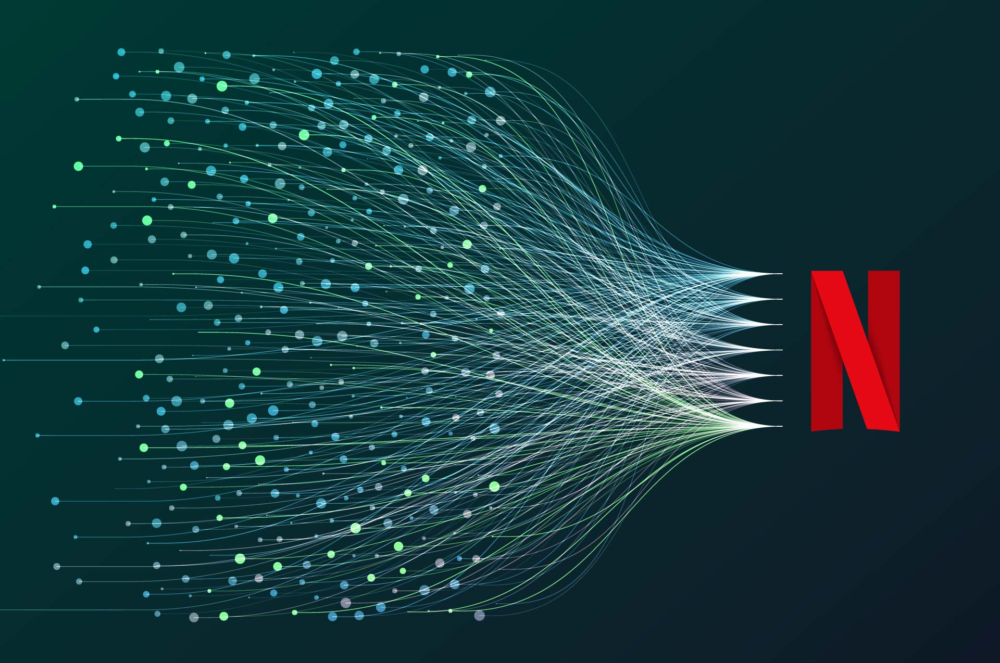

The task is to do cluster analysis on a Netflix dataset to find trends and group related things together. The dataset includes numerous information such as descriptions, actors, directors, kind, and nations, among others. The objective is to discover movie clusters based on these characteristics, enabling personalised recommendations, targeted marketing, and content classification. The research seeks to give useful insights about movie linkages and to allow data-driven decision-making in the field of entertainment.


# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [ ]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly as px
from sklearn.decomposition import PCA
import plotly.graph_objects as go
import warnings
warnings.filterwarnings('ignore')
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as shc
import missingno as miss
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import nltk
from nltk.tokenize import word_tokenize
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
nltk.download('averaged_perceptron_tagger')
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
import string
!pip install contractions
import contractions
from os import path
from PIL import Image
from collections import Counter
from nltk.corpus import stopwords
from datetime import datetime
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 22.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.8/110.8 kB 12.4 MB/s eta 0:00:00


### Dataset Loading

In [ ]:
# Load Dataset
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
filepath='/content/drive/MyDrive/AlmaBetter/Netflix/dataset/NETFLIX MOVIES AND TV SHOWS CLUSTERING (1).csv'
df=pd.read_csv(filepath)

### Dataset First View

In [ ]:
# Dataset First Look
df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...


### Dataset Rows & Columns count

In [ ]:
# Dataset Rows & Columns count
df.shape

(7787, 12)

### Dataset Information

In [ ]:
# Dataset Info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


In [ ]:
for col in df.columns:
  null_rate = df[col].isnull().sum() / len(df) * 100
  if null_rate > 0:
    print(f'Percentage of null values in {col} : {null_rate}%')

Percentage of null values in director : 30.679337357133683%
Percentage of null values in cast : 9.220495697958135%
Percentage of null values in country : 6.51085141903172%
Percentage of null values in date_added : 0.1284191601386927%
Percentage of null values in rating : 0.08989341209708489%


#### Duplicate Values

In [ ]:
# Dataset Duplicate Value Count
len(df[df.duplicated()])

0

#### Missing Values/Null Values

In [ ]:
# Missing Values/Null Values Count
df.isnull().sum()

show_id            0
type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

<BarContainer object of 12 artists>

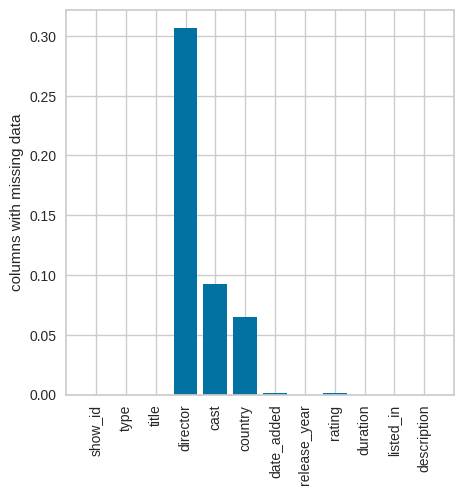

In [ ]:
# Visualizing the missing values
null_counts = df.isnull().sum()/len(df)
plt.figure(figsize=(5,5))
plt.xticks(np.arange(len(null_counts)),null_counts.index,rotation='vertical')
plt.ylabel('columns with missing data')
plt.bar(np.arange(len(null_counts)),null_counts)

<Axes: >

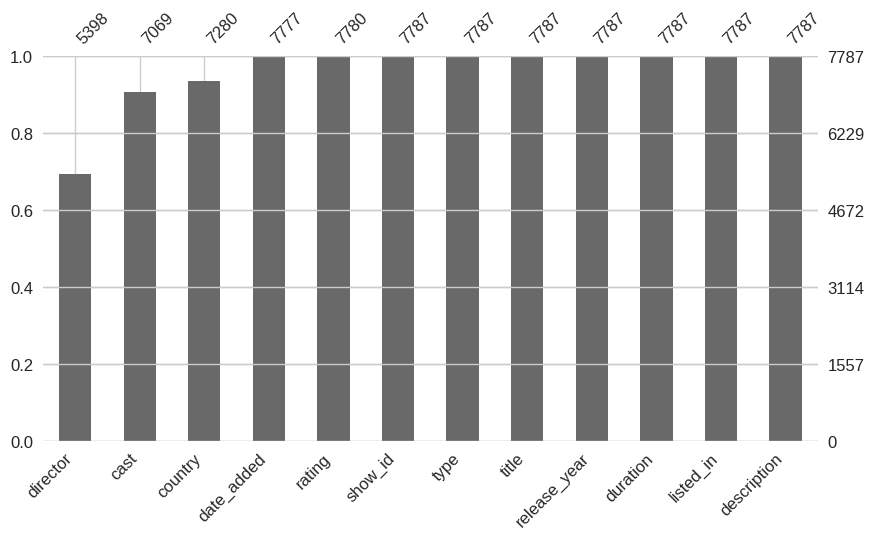

In [ ]:
# null value distribution
msno.bar(df, log=False, sort='ascending', figsize=(10,5), fontsize=12)

### What did you know about your dataset?

1. This dataset contains descriptions of Netflix TV episodes, movies, and web series.

2. There are 7787 rows and 12 columns.

3. There are 11 categorical columns and 1 numerical column.

4. There are no duplicate values present in dataset.

5. Null values are present in director, cast, country, date_added, and rating; because date_added and rating have very few null values, we will delete them from the data.



## ***2. Understanding Your Variables***

In [ ]:
# Dataset Columns
df.columns

Index(['show_id', 'type', 'title', 'director', 'cast', 'country', 'date_added',
       'release_year', 'rating', 'duration', 'listed_in', 'description'],
      dtype='object')

In [ ]:
# Dataset Describe
df.describe(include='all')

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
count,7787,7787,7787,5398,7069,7280,7777,7787.000000,7780,7787,7787,7787
unique,7787,2,7787,4049,6831,681,1565,NaN,14,216,492,7769
top,s1,Movie,3%,"Raúl Campos, Jan Suter",David Attenborough,United States,"January 1, 2020",NaN,TV-MA,1 Season,Documentaries,Multiple women report their husbands as missin...
freq,1,5377,1,18,18,2555,118,NaN,2863,1608,334,3
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.932580,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.757395,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1925.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018.000000,NaN,NaN,NaN,NaN


### Variables Description

1. show_id : Unique ID for every Movie / Tv Show
2. type : Identifier - A Movie or TV Show
3. title : Title of the Movie / Tv Show
4. director : Director of the Movie
5. cast : Actors involved in the movie / show
6. country : Country where the movie / show was produced
7. date_added : Date it was added on Netflix
8. release_year : Actual Releaseyear of the movie / show
9. rating : TV Rating of the movie / show
10. duration : Total Duration - in minutes or number of seasons
11. listed_in : Genre
12. description: The Summary description

### Check Unique Values for each variable.

In [ ]:
# Check Unique Values for each variable.
for i in df.columns.tolist():
  uni_value = df[i].nunique()
  print(f"No. of unique values in ",i,"is",uni_value,".")

No. of unique values in  show_id is 7787 .
No. of unique values in  type is 2 .
No. of unique values in  title is 7787 .
No. of unique values in  director is 4049 .
No. of unique values in  cast is 6831 .
No. of unique values in  country is 681 .
No. of unique values in  date_added is 1565 .
No. of unique values in  release_year is 73 .
No. of unique values in  rating is 14 .
No. of unique values in  duration is 216 .
No. of unique values in  listed_in is 492 .
No. of unique values in  description is 7769 .


## 3. ***Data Wrangling***

In [ ]:
# Let's tackle the missing values.

# Number of null values in date_added.
df.date_added.isnull().sum()

10

In [ ]:
# Remove null values in date_added.
df.dropna(subset=['date_added'], inplace=True)

In [ ]:
# Number of null values in rating.
df.rating.isnull().sum()

7

In [ ]:
# Remove null values in rating.
df.dropna(subset=['rating'], inplace=True)

In [ ]:
# Check the shape of our data.
df.shape

(7770, 12)

**Handling missing data in the director, cast, and country columns**

In [ ]:
df[['director','cast','country']] = df[['director','cast','country']].fillna('Unknown')
df.dropna(axis=0, inplace = True)

In [ ]:
df.isnull().sum()

show_id         0
type            0
title           0
director        0
cast            0
country         0
date_added      0
release_year    0
rating          0
duration        0
listed_in       0
description     0
dtype: int64

We handled every missing value in the dataset successfully.


### What all manipulations have you done and insights you found?

First, we removed null values from the date_added and rating columns.Then,in the columns director, cast, and nation null values were replaced by 'unknown'. The dataset now contains no missing values.

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

## **Type: Movie and TV Shows**

In [ ]:
Type=df['type'].value_counts()

Text(0, 0.5, 'Number of release.')

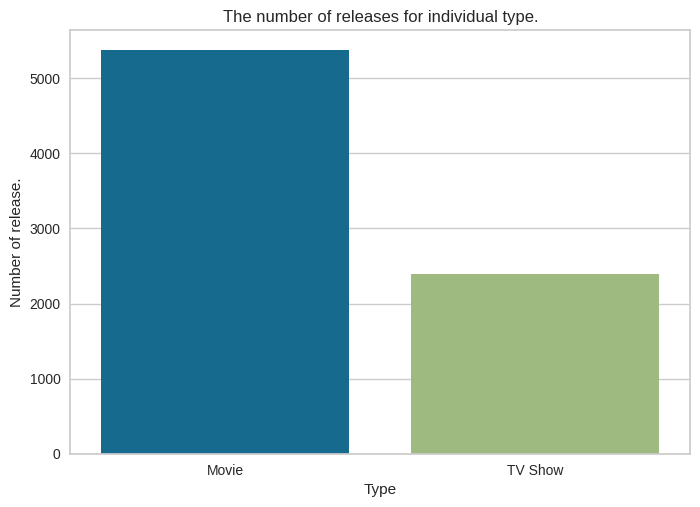

In [ ]:
sns.barplot(x=Type.index , y=Type)
plt.title('The number of releases for individual type.')
plt.xlabel('Type')
plt.ylabel('Number of release.')


##### 1. Why did you pick the specific chart?

Bar graphs provide a visual representation of data. They are used to show the relationship between two or more different types of data visually. To make the large amount of information easier to interpret visually, it is summarized in a bar graph. It offers a more detailed explanation of the patterns of the data than the table. It helps in quickly estimating the important values.

##### 2. What is/are the insight(s) found from the chart?

The quantity of movie releases exceeds the number of television shows released on Netflix.

## **Title**

**We will create a wordcloud to see which words appear the most in the titles for movies and tv shows.**

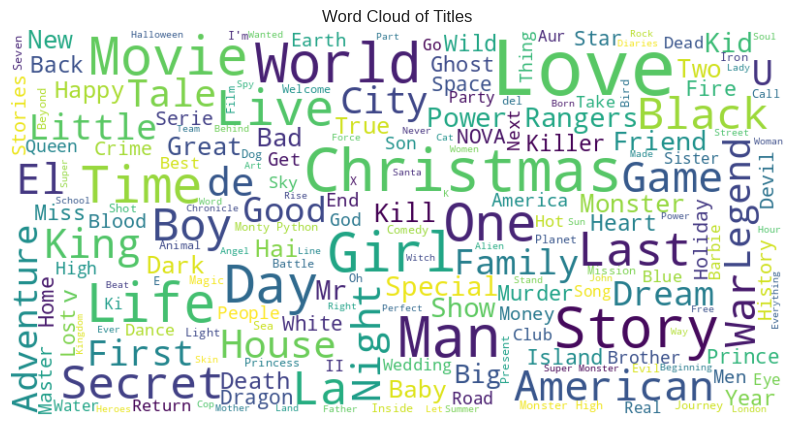

In [ ]:
# Load stopwords corpus
stopwords = set(stopwords.words('english'))

# Concatenate all titles into a single string
text = ' '.join(df['title'].astype(str))

# Create a word cloud object with custom settings
wordcloud = WordCloud(
    background_color='white',
    stopwords=stopwords,
    max_words=200,
    max_font_size=80,
    width=800,
    height=400,
    random_state=42
).generate(text)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Titles')
plt.show()


##### 1. Why did you pick the specific chart?

Word Clouds are graphic representations of words that highlight the terms that occur more frequently. When utilising the Mentimeter word cloud generator, the most commonly entered words by audience members will grow in size dynamically. This form of visualisation can assist presenters in rapidly gathering data from their audience, highlighting the most popular responses, and presenting the data in a fashion that everyone can easily understand.

##### 2. What is/are the insight(s) found from the chart?

1. The most often repeated terms in the title are Christmas, Love, World, Man, and Story.
2. We noticed that the majority of the films and television series were added over the winter, which explains why Christmas featured so frequently in the names.

## **Director**

**We are going to look at which filmmakers have produced the most films and television programs**.

In [ ]:
df.director.nunique()

4048

In [ ]:
# Count the number of unique directors for movies
movie_directors = df[df['type'] == 'Movie']['director'].nunique()

# Count the number of unique directors for TV shows
tv_show_directors = df[df['type'] == 'TV Show']['director'].nunique()

# Print the results
print("Number of directors for movies:", movie_directors)
print("Number of directors for TV shows:", tv_show_directors)

Number of directors for movies: 3908
Number of directors for TV shows: 178


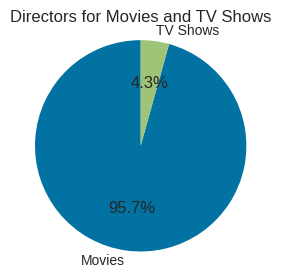

In [ ]:
# Assuming you have the number of directors for movies and TV shows
num_movie_directors = 3909
num_tv_show_directors = 177

# Create data for the pie chart
labels = ['Movies', 'TV Shows']
sizes = [num_movie_directors, num_tv_show_directors]

# Create the pie chart
plt.figure(figsize=(3, 3))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.title('Directors for Movies and TV Shows')

# Display the pie chart
plt.show()


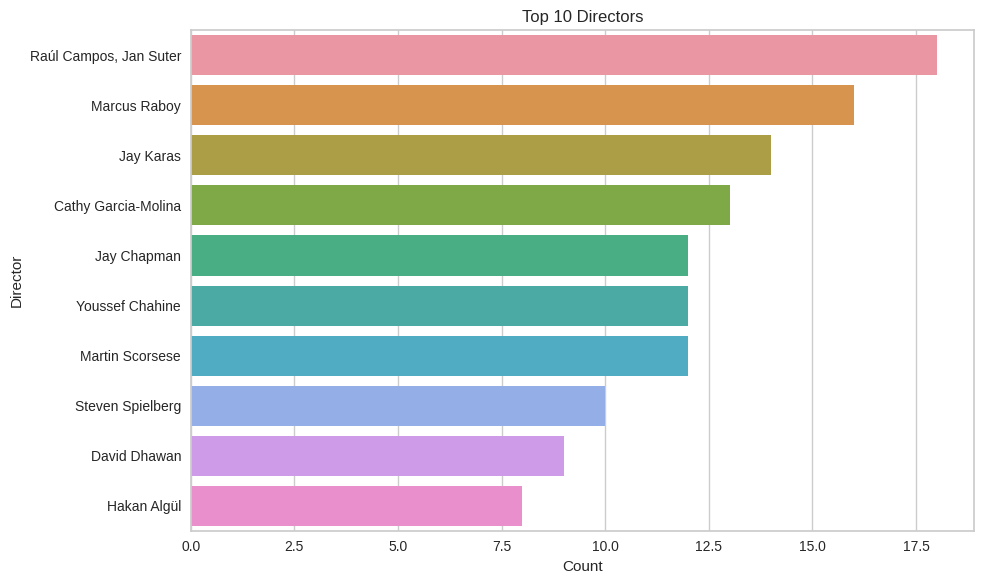

In [ ]:
# Count the number of occurrences of each director
director_counts =  df[~(df['director']=='Unknown')].director.value_counts().nlargest(10)


# Plot the bar plot with horizontal bars
plt.figure(figsize=(10, 6))
sns.barplot(x=director_counts.values, y=director_counts.index, orient='h')
plt.xlabel('Count')
plt.ylabel('Director')
plt.title('Top 10 Directors')
plt.tight_layout()
plt.show()


##### 1. Why did you pick the specific chart?

1. A pie chart depicts the portion relationship of your data. The area covered in a circle with different colours makes it easy to see how the percentages compare.

2. A bar graph is a data representation technique that uses rectangular bars to represent data. It enables data comparison and analysis.

##### 2. What is/are the insight(s) found from the chart?

1. There are 4050 number of directors.

2. There are 178 directors of TV shows and 3910 directors of movies.

3. Only 4.3% of directors are associated with TV shows, whereas 95.7% are associated with films.

4. Leading directors include Jay Karas, Marcus Raboy, Jan Suter, and Raul Campus.
5. Jan Suter and Raul Campos have each directed 18 of films or TV episodes, which is more than any other director in the dataset.

## **Cast**

**Let's see who has appeared in the most movies or TV shows.**

In [ ]:
df.cast.nunique()

6818

In [ ]:
df['cast'].isnull().sum()

0

In [ ]:
def to_list(df):
    cast_list = [str(cast).split(",") for cast in df['cast']]
    cast_count = Counter([actor.strip() for sublist in cast_list for actor in sublist])
    return cast_count


In [ ]:
# Call the convert_to_list function on the DataFrame
actors_count = to_list(df)

# Create a new DataFrame from the actors count dictionary
actors_df = pd.DataFrame.from_dict(actors_count, orient='index', columns=['Count'])
actors_df = actors_df[actors_df.index != 'Unknown']  # Exclude rows with 'Unknown' actor
actors_df.index.name = 'Actor'
actors_df = actors_df.sort_values(by='Count', ascending=False)



In [ ]:
actors_df

,Count
Actor,
Anupam Kher,42
Shah Rukh Khan,35
Naseeruddin Shah,30
Om Puri,30
Takahiro Sakurai,29
...,...
Mylene Dizon,1
Lorenz Martinez,1
Art Acuña,1


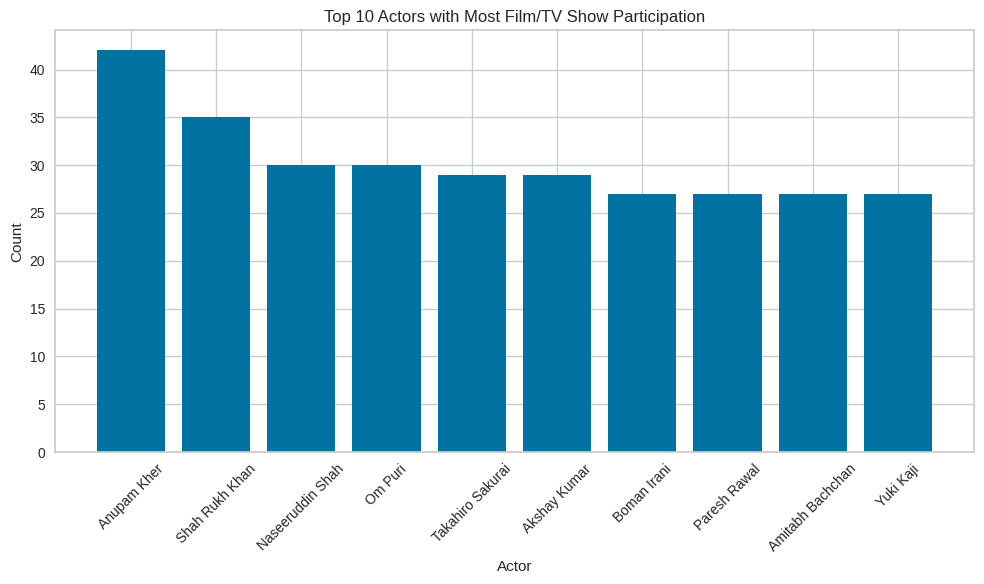

In [ ]:
# Get the top 10 actors with the highest counts
top_actors = actors_df.head(10)

# Plot the bar chart
plt.figure(figsize=(10, 6))
plt.bar(top_actors.index, top_actors['Count'])
plt.xlabel('Actor')
plt.ylabel('Count')
plt.title('Top 10 Actors with Most Film/TV Show Participation')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

##### 1. Why did you pick the specific chart?

A bar graph is a type of data visualization tool that uses rectangular bars to depict data. It allows for data comparison and analysis. The bar chart depicts the top 10 actors who appear in the majority of films and television series.

##### 2. What is/are the insight(s) found from the chart?

1. There are 6831 actors who participate in the movies or TV Shows.


2. According to our chart, the most frequently featured actors are Anupam Kher, Shahrukh Khan, and Om Naseeruddin Shah.



## **Country**

**Now lets see how much content is produced by each country.**


In [ ]:
# Top countries
df.country.value_counts()

United States                                                   2546
India                                                            923
Unknown                                                          505
United Kingdom                                                   396
Japan                                                            224
                                                                ... 
Russia, United States, China                                       1
Italy, Switzerland, France, Germany                                1
United States, United Kingdom, Canada                              1
United States, United Kingdom, Japan                               1
Sweden, Czech Republic, United Kingdom, Denmark, Netherlands       1
Name: country, Length: 682, dtype: int64

Text(0.5, 1.0, ' Top 10 countries with the highest number of shows')

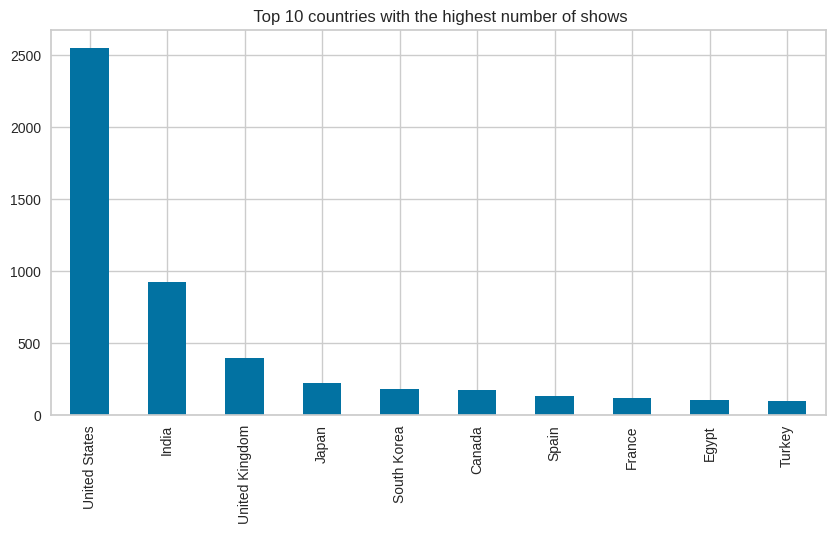

In [ ]:
# Top 10 countries with the highest number movies / TV shows in the dataset
plt.figure(figsize=(10,5))
df[~(df['country']=='Unknown')].country.value_counts().nlargest(10).plot(kind='bar')
plt.title(' Top 10 countries with the highest number of shows')

In [ ]:
# % share of movies / tv shows by top 3 countries
df.country.value_counts().nlargest(3).sum()/len(df)*100

51.14543114543114

In [ ]:
df['country'].nunique()

682

In [ ]:
def group_actors_by_country(df):
    # Assuming you have a DataFrame named 'df' with columns 'cast' and 'country'

    actors_by_country = {}

    for index, row in df.iterrows():
        cast = str(row['cast']).split(",")
        country = row['country']

        for actor in cast:
            actor = actor.strip()
            if actor:
                actors_by_country.setdefault(country, []).append(actor)

    return actors_by_country


In [ ]:
actors_by_country_df = group_actors_by_country(df) # grouped Actors according to Country
print(actors_by_country_df)

{'Brazil': ['João Miguel', 'Bianca Comparato', 'Michel Gomes', 'Rodolfo Valente', 'Vaneza Oliveira', 'Rafael Lozano', 'Viviane Porto', 'Mel Fronckowiak', 'Sergio Mamberti', 'Zezé Motta', 'Celso Frateschi', 'Unknown', 'Gloria Groove', 'Alexia Twister', 'Afonso Padilha', 'Loo Nascimento', 'Ingrid Silva', 'Rincon Sapiência', 'Batekoo', 'Gabriel Martins', 'Benjamin Abras', 'Daniele DaMata', 'Tasha & Tracie Okereke', 'Mariana de Matos', 'André Novais', 'Mahal Pita', 'Grace Passô', 'Thamyra Thâmara', 'Xenia França', 'Criola', 'Dani Ornellas', 'Anelis Assumpção', 'Magá Moura', 'Tássia Reis', 'Liniker', 'Yasmin Thayná', 'Raquel Virgínia', 'Juliana Luna', 'Erica Malunguinho', 'Diane Lima', 'Karol Conká', 'Anne Celestino Mota', 'Emmanuel Rosset', 'Matheus Moura', 'Surya Amitrano', 'Thaís Schier', 'Cida Rolim', 'Katia Horn', 'Igor Augustho', 'Marcel Szymanski', 'Johnny Massaro', 'Bianca Comparato', 'Regina Braga', 'Maria Laura Nogueira', 'Victor Mendes', 'Thiago Amaral', 'Rafael Primot', 'Eduardo

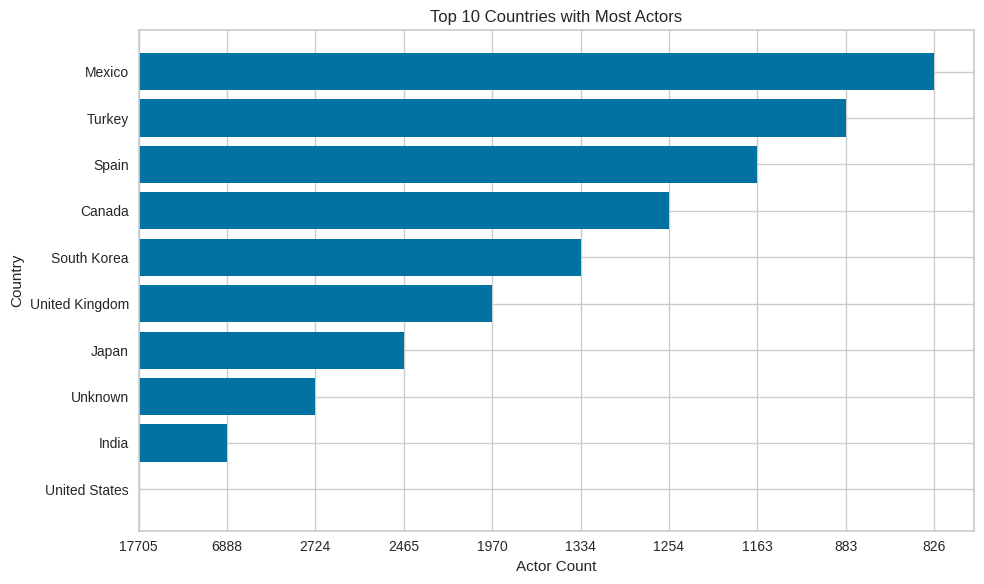

In [ ]:
def plot_actors_by_country(actors_by_country_dict):
    # Sort the dictionary by the number of actors in each country in descending order
    sorted_countries = sorted(actors_by_country_dict.keys(), key=lambda x: len(actors_by_country_dict[x]), reverse=True)

    # Get the top 10 countries with the most actors and their corresponding actor counts
    top_countries = sorted_countries[:10]
    actor_counts = [len(actors_by_country_dict[country]) for country in top_countries]

    # Sort the top countries and actor counts together
    top_countries, actor_counts = zip(*sorted(zip(top_countries, actor_counts), key=lambda x: x[1], reverse=False))

    # Convert country names and actor counts to strings
    top_countries = [str(country) for country in top_countries]
    actor_counts = [str(count) for count in actor_counts]

    # Plot the horizontal bar chart
    plt.figure(figsize=(10, 6))
    plt.barh(top_countries, actor_counts)
    plt.xlabel('Actor Count')
    plt.ylabel('Country')
    plt.title('Top 10 Countries with Most Actors')
    plt.tight_layout()
    plt.show()

plot_actors_by_country(actors_by_country_df)


##### 1. Why did you pick the specific chart?

A type of data visualization tool called a bar graph utilises rectangular bars to represent data. It enables the examination and comparison of data.  Here, it shows a visualization of the content that every country produces and the number of performers from each country.

##### 2. What is/are the insight(s) found from the chart?

1. There are 681 countries.
2. The United States has the most TV shows and movie programs in the dataset. followed by India and the United Kingdom respectively.
3. 51% of total content is produced by US, India and UK.
4. Maximum number of actors are from Maxico.

## **date_added**

**Number of shows added over the years**

In [ ]:
df['date_added']

0          August 14, 2020
1        December 23, 2016
2        December 20, 2018
3        November 16, 2017
4          January 1, 2020
               ...        
7782      October 19, 2020
7783         March 2, 2019
7784    September 25, 2020
7785      October 31, 2020
7786         March 1, 2020
Name: date_added, Length: 7770, dtype: object

In [ ]:
df['date_added'].unique()

array(['August 14, 2020', 'December 23, 2016', 'December 20, 2018', ...,
       'December 6, 2018', 'March 9, 2016', 'January 11, 2020'],
      dtype=object)

In [ ]:
def count_films_by_year(df):
    # Convert the added_date column to datetime format
    df['date_added'] = pd.to_datetime(df['date_added'])

    # Extract the year from the added_date and create a new column
    df['year'] = df['date_added'].dt.year

    # Count the occurrences of each year
    films_by_year = df['year'].value_counts().sort_index().to_dict()

    return films_by_year


In [ ]:
films_by_year = count_films_by_year(df) # count the number of releases per year
print(films_by_year)

{2008: 2, 2009: 2, 2010: 1, 2011: 13, 2012: 3, 2013: 11, 2014: 25, 2015: 88, 2016: 440, 2017: 1222, 2018: 1684, 2019: 2153, 2020: 2009, 2021: 117}


In [ ]:
# Convert the date_added column to datetime format
df['date_added'] = pd.to_datetime(df['date_added'])

# Extract the year from the date_added and create a new column
df['year'] = df['date_added'].dt.year

# Count the occurrences of each year
year_counts = df['year'].value_counts().sort_index()

# Create a bar chart using Plotly
fig = go.Figure(data=go.Bar(x=year_counts.index, y=year_counts.values))
fig.update_layout(title='Number of Movies and TV Shows Added to Netflix per Year',
                  xaxis_title='Year', yaxis_title='Number of Movies and TV Shows')
fig.show()


**Monthly addition of movies and TV Shows**

In [ ]:
# Convert the date_added column to datetime format
df['date_added'] = pd.to_datetime(df['date_added'])

# Extract the month from the date_added and create a new column
df['month_added'] = df['date_added'].dt.month

# Count the occurrences of each month
month_counts = df['month_added'].value_counts().sort_index()

# Map month numbers to month names
month_names = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
month_labels = [month_names[int(i) - 1] for i in month_counts.index]

# Create a bar chart using Plotly
fig = go.Figure(data=go.Bar(x=month_labels, y=month_counts.values))
fig.update_layout(title='Number of Movies Added to Netflix by Month',
                  xaxis_title='Month', yaxis_title='Number of Movies Added')
fig.show()


##### 1. Why did you pick the specific chart?

Plotly visualizations provide effective visualization of categorical data, easy comparison, interactive features, customization options, integration with other visualizations, and sharing and embedding capabilities for a cohesive data exploration experience. above plots shows number of added movie or tv shows according to year and second highest added movies or tv shows in which month.

##### 2. What is/are the insight(s) found from the chart?

1. Data is showing releases between 2008 to 2021.
2. In 2019, the most content was added.
3. Maximum number of  movies and tv shows were released in the month of December.

## **release_year**

In [ ]:
df['release_year'].unique()

array([2020, 2016, 2011, 2009, 2008, 2019, 1997, 2017, 2018, 2014, 2015,
       2010, 2005, 2013, 2012, 2006, 2000, 2003, 1989, 2004, 1977, 1971,
       1993, 2007, 1998, 1988, 1996, 2002, 1986, 1990, 1979, 1980, 1974,
       2001, 1999, 1966, 1991, 1982, 1994, 1995, 1978, 1992, 1972, 1975,
       2021, 1973, 1967, 1960, 1981, 1958, 1976, 1968, 1956, 1985, 1965,
       1984, 1983, 1987, 1945, 1946, 1962, 1925, 1942, 1969, 1955, 1963,
       1964, 1954, 1970, 1944, 1947, 1959, 1943])

In [ ]:
def count_films_by_year(df):
    films_by_year = df['release_year'].value_counts().sort_index().to_dict()
    return films_by_year

In [ ]:
films_by_year_dict = count_films_by_year(df)
films_by_year_dict

{1925: 1,
 1942: 2,
 1943: 3,
 1944: 3,
 1945: 3,
 1946: 2,
 1947: 1,
 1954: 2,
 1955: 3,
 1956: 2,
 1958: 3,
 1959: 1,
 1960: 4,
 1962: 3,
 1963: 2,
 1964: 1,
 1965: 2,
 1966: 1,
 1967: 5,
 1968: 5,
 1969: 2,
 1970: 2,
 1971: 5,
 1972: 4,
 1973: 10,
 1974: 7,
 1975: 6,
 1976: 9,
 1977: 7,
 1978: 6,
 1979: 11,
 1980: 9,
 1981: 9,
 1982: 15,
 1983: 9,
 1984: 9,
 1985: 9,
 1986: 10,
 1987: 7,
 1988: 16,
 1989: 13,
 1990: 20,
 1991: 17,
 1992: 18,
 1993: 22,
 1994: 16,
 1995: 19,
 1996: 19,
 1997: 30,
 1998: 31,
 1999: 33,
 2000: 34,
 2001: 36,
 2002: 45,
 2003: 47,
 2004: 59,
 2005: 73,
 2006: 85,
 2007: 85,
 2008: 124,
 2009: 137,
 2010: 171,
 2011: 166,
 2012: 218,
 2013: 265,
 2014: 334,
 2015: 536,
 2016: 881,
 2017: 1010,
 2018: 1120,
 2019: 996,
 2020: 868,
 2021: 31}

In [ ]:
def plot_films_by_year(films_by_year_dict):
    years = list(films_by_year_dict.keys())
    counts = list(films_by_year_dict.values())

    fig = go.Figure(data=go.Bar(x=years, y=counts))
    fig.update_layout(title='Number of content Released by Year', xaxis_title='Year', yaxis_title='Count')
    fig.show()


In [ ]:
plot_films_by_year(films_by_year_dict)

**Let's look at an analysis of content released throughout the course of the year by content type.**

In [ ]:
# Filter the DataFrame by content type
df_tvshow = df[df['type'] == 'TV Show']
df_movie = df[df['type'] == 'Movie']

# Count the content releases by year for TV shows
tvshow_counts = df_tvshow['release_year'].value_counts().sort_index()

# Count the content releases by year for movies
movie_counts = df_movie['release_year'].value_counts().sort_index()

# Create the bar chart traces
trace_tvshow = go.Bar(
    x=tvshow_counts.index,
    y=tvshow_counts.values,
    name='TV Shows',
    marker=dict(color='rgb(249, 6, 6)')
)

trace_movie = go.Bar(
    x=movie_counts.index,
    y=movie_counts.values,
    name='Movies',
    marker=dict(color='rgb(26, 118, 255)')
)

# Set the layout of the chart
layout = go.Layout(
    template='plotly_dark',
    title='CONTENT RELEASE OVER THE YEAR BY CONTENT TYPE',
    xaxis=dict(title='Year'),
    yaxis=dict(title='Count'),
    barmode='group'  # Display bars in groups
)

# Create the figure and show the chart
fig = go.Figure(data=[trace_tvshow, trace_movie], layout=layout)
fig.show(renderer='colab')


##### 1. Why did you pick the specific chart?

Plotly visualizations provide categorical data analysis, easy comparison, interactive features, customization, and sharing options for seamless data exploration. The graphs above show the number of movie releases per year as well as the number of releases by type.

##### 2. What is/are the insight(s) found from the chart?

1. The release years for films in the collection range from 1925 to 2021.
2. We are able to see that there has been a huge increase in content releases between 2010 and 2020.
3. In 2017, the most films were released—742 in total.
4. In 2020, the most TV Shows were released-457 in total.

## **Rating**

analysis of age ratings for released content

In [ ]:
df['rating']

0       TV-MA
1       TV-MA
2           R
3       PG-13
4       PG-13
        ...  
7782    TV-MA
7783    TV-14
7784    TV-MA
7785    TV-PG
7786    TV-MA
Name: rating, Length: 7770, dtype: object

In [ ]:
df['rating'].unique()

array(['TV-MA', 'R', 'PG-13', 'TV-14', 'TV-PG', 'NR', 'TV-G', 'TV-Y',
       'TV-Y7', 'PG', 'G', 'NC-17', 'TV-Y7-FV', 'UR'], dtype=object)

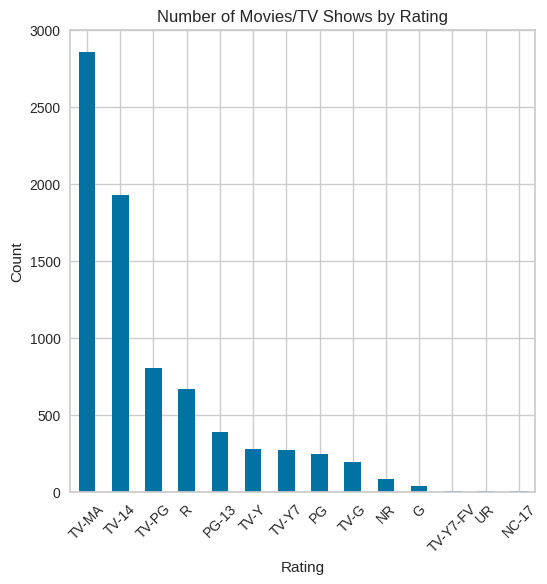

In [ ]:
rating_counts=df['rating'].value_counts()
# Create a bar chart using Matplotlib
plt.figure(figsize=(6, 6))
rating_counts.plot(kind='bar')
plt.xlabel('Rating')
plt.ylabel('Count')
plt.title('Number of Movies/TV Shows by Rating')
plt.xticks(rotation=45)
plt.show()


**Let's analyse how much content every audience group receives.**

Here are the definitions for all of the ratings.

1. **TV-MA** :- For Mature Audiences
2. **TV-14** :- Unsuitable for children under 14 years of age
3. **TV-PG** :- Parental Guidance Suggested for television
4. **R** :- Restricted, Children Under 17 Require Accompanying Parent or Adult Guardian
5. **PG-13** :- Inappropriate for children under 13
6. **TV-Y** :- Appropriate for children of all ages
7. **TV-Y7** :- Designed for children ages 7 and older
8. **PG** :- Parental Guidance Suggested feature films
9. **TV-G** :- Acceptable for the entire, general audience, including children for television
10. **NR** :- Not Rated
11. **G** :- General Audience; Suitable for all ages
12. **TV-Y7-FV** :- Program contains “fantasy violence” that may be more intense or combative than other TV-Y7 programs.
13. **UR** :- Unrated
14. **NC-17** :- No children under 17

In [ ]:
# assigning ratings based on age-appropriate groups
rating_map = {'TV-MA':'Adults',
              'R':'Adults',
              'PG-13':'Teens',
              'TV-14':'Young Adults',
              'TV-PG':'Kids',
              'NR':'Adults',
              'TV-G':'Kids',
              'TV-Y':'Kids',
              'TV-Y7':'Teens',
              'PG':'Kids',
              'G':'Kids',
              'NC-17':'Young Adults',
              'TV-Y7-FV':'Kids',
              'UR':'Adults'}

df['rating'].replace(rating_map, inplace = True)
df['rating'].unique()

array(['Adults', 'Teens', 'Young Adults', 'Kids'], dtype=object)

<Axes: xlabel='rating', ylabel='count'>

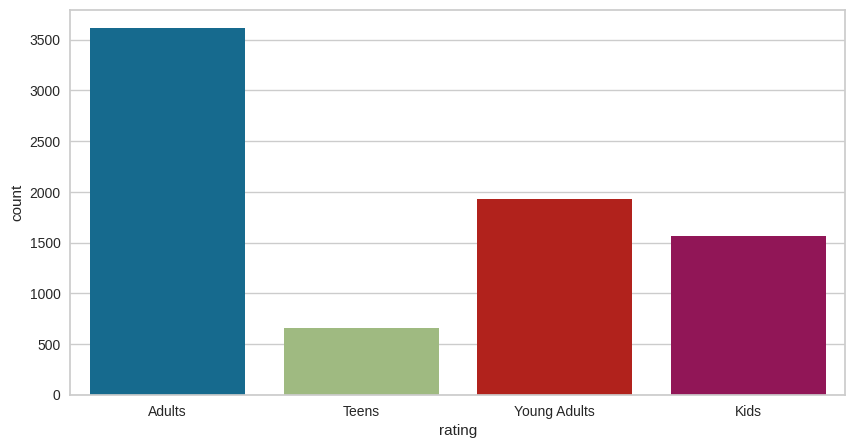

In [ ]:
plt.figure(figsize=(10,5))
sns.countplot(x='rating',data=df)

##### 1. Why did you pick the specific chart?

A bar graph is a sort of data visualisation tool that uses rectangular bars to display data. It makes it possible to examine and contrast facts. Here, a visualisation of the rating count for films and TV series is displayed.

##### 2. What is/are the insight(s) found from the chart?

1. There are total 14 type of rating present in the dataset.

2. Maximum content falls under TV-MA rating followed by TV-14 and TV-PG Ratings.

3. Around 50% of shows on Netflix are produced for an adult audience. Followed by young adults and kids. Netflix has fewer shows that are specifically produced for teenagers than other age groups.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

By producing material specifically for young people and adults, Netflix caters to a wide audience mix, bringing in new viewers and increasing involvement.
1. If Netflix fails to offer enough content targeted towards teenagers, it may miss out on capturing a substantial portion of this market.
2. Netflix could collaborate with well-known production companies or writers who focus on teen-oriented material. This may help in introducing new, interesting information that appeals to the teenage audience.

## **duration**

Let's analyse the content based on its duration.

In [ ]:
df['duration']

0       4 Seasons
1          93 min
2          78 min
3          80 min
4         123 min
          ...    
7782       99 min
7783      111 min
7784       44 min
7785     1 Season
7786       90 min
Name: duration, Length: 7770, dtype: object

In [ ]:
df['duration'].unique()

array(['4 Seasons', '93 min', '78 min', '80 min', '123 min', '1 Season',
       '95 min', '119 min', '118 min', '143 min', '103 min', '89 min',
       '91 min', '149 min', '144 min', '124 min', '87 min', '110 min',
       '128 min', '117 min', '100 min', '2 Seasons', '84 min', '99 min',
       '90 min', '102 min', '104 min', '105 min', '56 min', '125 min',
       '81 min', '97 min', '106 min', '107 min', '109 min', '44 min',
       '75 min', '101 min', '3 Seasons', '113 min', '114 min', '130 min',
       '94 min', '140 min', '135 min', '82 min', '70 min', '121 min',
       '92 min', '164 min', '53 min', '83 min', '116 min', '86 min',
       '120 min', '96 min', '126 min', '129 min', '77 min', '137 min',
       '148 min', '28 min', '122 min', '176 min', '85 min', '22 min',
       '68 min', '111 min', '29 min', '142 min', '168 min', '21 min',
       '59 min', '20 min', '98 min', '108 min', '76 min', '26 min',
       '156 min', '30 min', '57 min', '150 min', '133 min', '115 min',
       '

In [ ]:
df['duration'].isnull().sum()

0

In [ ]:
# Extract the season and minute values from the duration column
df['duration'] = df['duration'].astype(str)  # Convert duration column to string type
df['seasons'] = df['duration'].str.extract('(\d+) Seasons?', expand=False)  # Extract season values
df['minutes'] = df['duration'].str.extract('(\d+) min', expand=False)  # Extract minute values

# Display the resulting DataFrame
print(df[['duration', 'seasons', 'minutes']])


       duration seasons minutes
0     4 Seasons       4     NaN
1        93 min     NaN      93
2        78 min     NaN      78
3        80 min     NaN      80
4       123 min     NaN     123
...         ...     ...     ...
7782     99 min     NaN      99
7783    111 min     NaN     111
7784     44 min     NaN      44
7785   1 Season       1     NaN
7786     90 min     NaN      90

[7770 rows x 3 columns]


In [ ]:
def categorize_duration(row): # create a function to distribute the shows and movies according to their duration.
    if pd.notnull(row['seasons']):
        if int(row['seasons']) <= 2:
            return 'Short TV Show'
        else:
            return 'Long TV Show'
    elif pd.notnull(row['minutes']):
        if int(row['minutes']) <= 120:
            return 'Short Movie'
        else:
            return 'Long Movie'
    else:
        return 'Unknown'

# Apply the categorization function to create a new 'duration_category' column
df['duration_category'] = df.apply(categorize_duration, axis=1)

# Count the occurrences of each duration category
duration_counts = df['duration_category'].value_counts()

# Display the results
print(duration_counts)


Short Movie      4361
Short TV Show    1984
Long Movie       1011
Long TV Show      414
Name: duration_category, dtype: int64


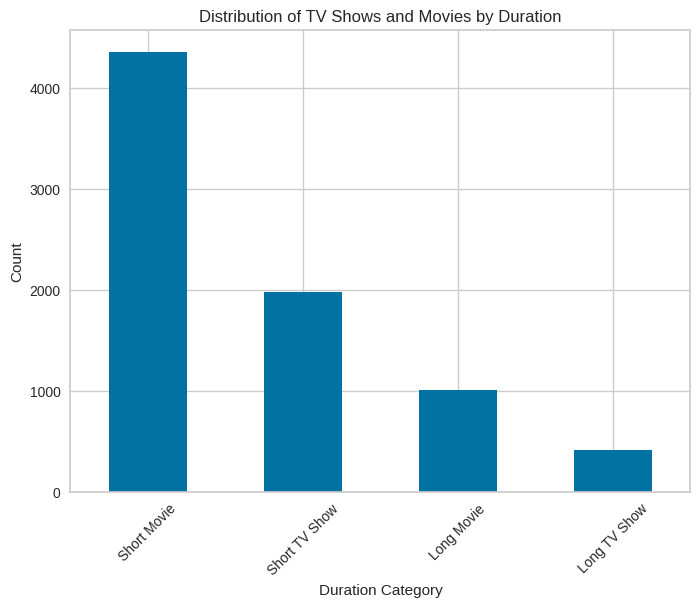

In [ ]:
# Count the occurrences of each duration category
duration_counts = df['duration_category'].value_counts()

# Create a bar chart using Matplotlib
plt.figure(figsize=(8, 6))
duration_counts.plot(kind='bar')
plt.xlabel('Duration Category')
plt.ylabel('Count')
plt.title('Distribution of TV Shows and Movies by Duration')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Calculate the percentage of each duration category
duration_percentage = (df['duration_category'].value_counts() / len(df)) * 100

# Create a pie chart using Plotly
fig = go.Figure(data=go.Pie(labels=duration_percentage.index, values=duration_percentage))

# Update the layout of the chart
fig.update_layout(title='Distribution of TV Shows and Movies by Duration')

# Display the chart
fig.show()


##### 1. Why did you pick the specific chart?

A bar chart which represent the count of the distribution of the shows and movies according to their duration.

A plotly pie chart to represent same into fraction so get better idea.

##### 2. What is/are the insight(s) found from the chart?

Netflix focuses largely on short movies, then short TV shows, long movies, and long TV shows. Here is a more accurate breakdown of the percentages:

1. Short Movies: A little over 56.1% of Netflix's programming is made up of films that are under 120 minutes long.

2. TV shows: With fewer than two seasons make up about 25.6% of the programming on Netflix.

3. Long Films: Approximately 13% of Netflix's programming consists of films that are longer than 120 minutes.

4. Long TV Shows: About 5.39% of Netflix's programming consists of TV series that have more than two seasons.



##### 3. Will the gained insights help creating a positive business impact? Are there any insights that lead to negative growth? Justify with specific reason.

1. Netflix provides a variety of material that draws viewers and promotes creativity for up-and-coming filmmakers and producers.
2. Netflix's lack of content depth may hurt its ability to keep users who want rich narratives and complicated plotlines. In addition, the platform could ignore long-running shows with continuous narratives and character arcs, potentially losing them to competitors.
3. Netflix can enhance its content strategy by investing in long-format movies and TV shows, partnering with renowned filmmakers and content creators, and utilizing data-driven decision-making to identify opportunities for content development and acquisition.

## **listed_in**

We will now do content genre analysis

In [ ]:
df['listed_in']

0       International TV Shows, TV Dramas, TV Sci-Fi &...
1                            Dramas, International Movies
2                     Horror Movies, International Movies
3       Action & Adventure, Independent Movies, Sci-Fi...
4                                                  Dramas
                              ...                        
7782                         Dramas, International Movies
7783       Dramas, International Movies, Music & Musicals
7784    Documentaries, International Movies, Music & M...
7785                   International TV Shows, Reality TV
7786                      Documentaries, Music & Musicals
Name: listed_in, Length: 7770, dtype: object

In [ ]:
df['listed_in'].nunique()

491

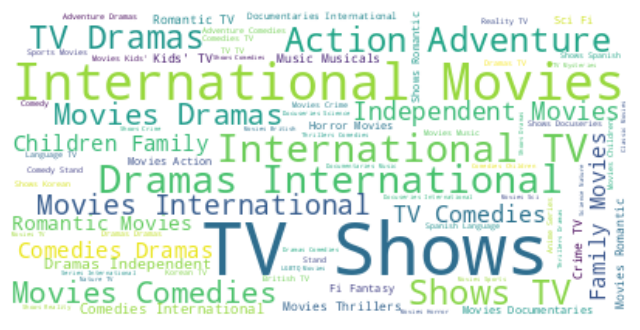

In [ ]:
# Combine all the listed_in values into a single string
text = ' '.join(df['listed_in'].dropna().values)

# Create the word cloud
wordcloud = WordCloud(background_color='white').generate(text)

# Display the word cloud using Matplotlib
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [ ]:
# Convert the genre column to a list
genre_list = df['listed_in'].str.split(", ")

# Flatten the genre list
genre_flat = [genre for sublist in genre_list for genre in sublist]

# Count the occurrences of each genre
genre_count = pd.Series(genre_flat).value_counts().sort_values(ascending=False)

# Create the genre DataFrame
genre_df = pd.DataFrame({'Genre': genre_count.index, 'Count': genre_count.values})

# Show the genre distribution
genre_df


,Genre,Count
0,International Movies,2437
1,Dramas,2105
2,Comedies,1471
3,International TV Shows,1197
4,Documentaries,786
5,Action & Adventure,721
6,TV Dramas,703
7,Independent Movies,673
8,Children & Family Movies,532
9,Romantic Movies,531


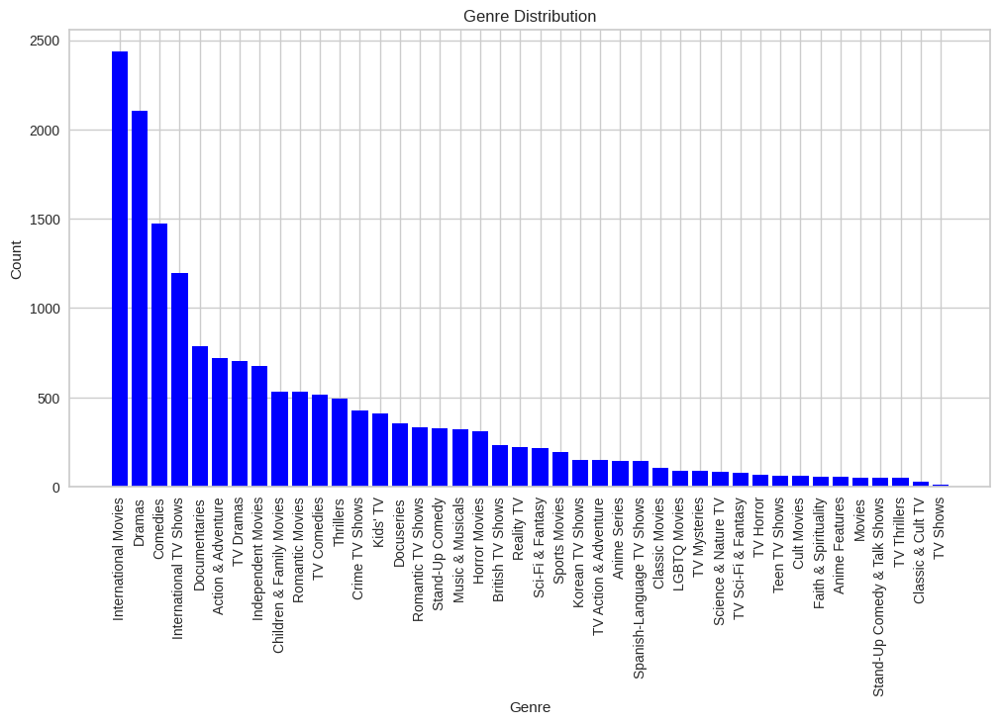

In [ ]:
# Sort the genre DataFrame by count in descending order
genre_df_sorted = genre_df.sort_values('Count', ascending=False)

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(12, 6))

# Plot the bar chart
ax.bar(genre_df_sorted['Genre'], genre_df_sorted['Count'], color='blue')

# Set the labels and title
ax.set_xlabel('Genre')
ax.set_ylabel('Count')
ax.set_title('Genre Distribution')

# Rotate the x-axis labels for better readability
plt.xticks(rotation=90)

# Display the chart
plt.show()


##### 1. Why did you pick the specific chart?

1. Word cloud generator creates dynamically scaled word clouds that highlight commonly input terms for audience data collecting and simple interpretation by displaying popular responds.
2. A bar graph is a graphical representation of data that uses certain forms to highlight categories, with one axis indicating a column and another axis representing values or counts. It may be graphed either vertically or horizontally.

##### 2. What is/are the insight(s) found from the chart?

1. There are 492 unique values present in the dataset.
2. There are some frequent words we seen in the world cloud like Action, Adventure, International Movies, Comedies, etc.
3. Most countries appear to prefer dramas, international movies, and comedies.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Netflix increases user engagement through personalizing content suggestions, focusing on foreign audiences, and expanding into high-demand regions.
1. Limited genre variety in dramas, foreign films, and comedies may have a negative impact on users and involvement while ignoring other audiences and demands.
2. Utilizing data analytics, customer input, market research, and cooperation with foreign content providers, Netflix can improve content selection and suggestions.

## **description**

Building a wordcloud for the movie descriptions

In [ ]:
df['description']

0       In a future where the elite inhabit an island ...
1       After a devastating earthquake hits Mexico Cit...
2       When an army recruit is found dead, his fellow...
3       In a postapocalyptic world, rag-doll robots hi...
4       A brilliant group of students become card-coun...
                              ...                        
7782    When Lebanon's Civil War deprives Zozo of his ...
7783    A scrappy but poor boy worms his way into a ty...
7784    In this documentary, South African rapper Nast...
7785    Dessert wizard Adriano Zumbo looks for the nex...
7786    This documentary delves into the mystique behi...
Name: description, Length: 7770, dtype: object

In [ ]:
df['description'].nunique()

7752

In [ ]:
df['description'].isnull().sum()

0

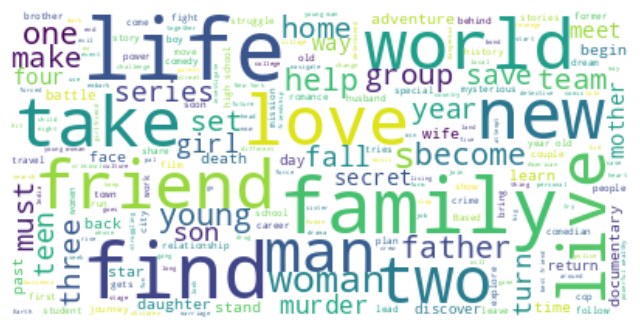

In [ ]:
# Combine all the descriptions into a single string
text = ' '.join(df['description'].dropna().values)

# Create the word cloud
wordcloud = WordCloud(background_color='white').generate(text)

# Display the word cloud using Matplotlib
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

##### 1. Why did you pick the specific chart?

Word cloud generator creates dynamically scaled word clouds that highlight commonly input terms for audience data collecting and simple interpretation by displaying popular responds.

##### 2. What is/are the insight(s) found from the chart?

1. There are 7769 summaries present in the description dataset.

2. There are some frequent words we can see in the world cloud like family, friend, love, life, etc.

# **Bivariate analysis**

Now we'll look at country-by-country release analysis.

In [ ]:
# Group the data by country and calculate the total number of releases
country_counts = df.groupby('country')['type'].value_counts().unstack().reset_index().fillna(0)
country_counts['Total'] = country_counts['TV Show'] + country_counts['Movie']

# Create a choropleth trace for total releases
trace_total_releases = go.Choropleth(
    locations = country_counts['country'],
    locationmode = 'country names',
    z = country_counts['Total'],
    text = country_counts['country'],
    colorscale = 'BuGn',
    reversescale = True,
    colorbar = dict(title = 'Total Releases'),
    name = 'Total Releases'
)

# Create the layout
layout = go.Layout(
    title = 'Total Number of Releases (TV Shows + Movies) per Country',
    geo = dict(
        showframe = False,
        showcoastlines = True,
        projection_type = 'natural earth'
    )
)

# Create the figure
fig = go.Figure(data=[trace_total_releases], layout=layout)

# Show the figure
fig.show()


##### 1. Why did you pick the specific chart?

Choropleth maps are a simple approach to display how a measurement changes throughout a geographic area or the amount of variability within a region. Like a heatmap but with geographic borders.

##### 2. What is/are the insight(s) found from the chart?

Choropeth trace tell about the total number of releases as per country like India have 923 releases, Brazil have 72 releases, and so on.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

The gained insights about the total number of releases per country, such as India having 923 releases and Brazil having 72 releases, can potentially have both positive and negative business impacts
1. Netflix's market penetration and expansion efforts are influenced by country releases, with higher numbers in India indicating strong presence and investment. Targeting specific regions, local partnerships, and original productions informs decision-making.
2. Netflix's focus on high-release countries may hinder growth, while neglecting lower-release countries may miss untapped audiences and subscribers.
3. Netflix can expand its reach by investing in localization, market analysis, and diversifying content to attract lower-release viewers and stimulate growth.

**Now let's compare the releases of films and television series in the top 10 content-producing countries.**

In [ ]:
def draw_pie_charts_top_10(df):
    # Group the DataFrame by country and calculate the count of TV shows and movies
    grouped_df = df.groupby('country')['type'].value_counts().unstack().fillna(0)

    # Get the top 10 countries with the highest total releases
    top_10_countries = grouped_df.sum(axis=1).nlargest(10).index

    # Iterate over each top country and create a pie chart
    for country in top_10_countries:
        # Get the counts of TV shows and movies for the country
        tv_shows_count = grouped_df.loc[country, 'TV Show']
        movies_count = grouped_df.loc[country, 'Movie']

        # Create labels and sizes for the pie chart
        labels = ['TV Shows', 'Movies']
        sizes = [tv_shows_count, movies_count]

        # Create the pie chart
        plt.figure(figsize=(3, 3))
        plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
        plt.title(f'Releases in {country}')
        plt.axis('equal')
        plt.show()


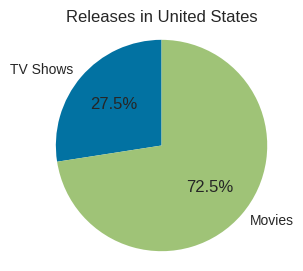

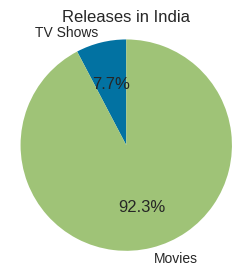

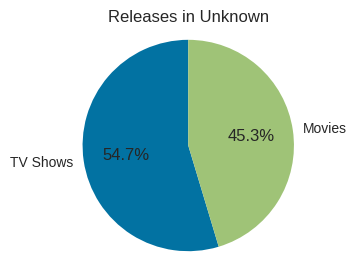

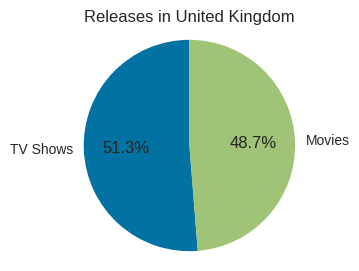

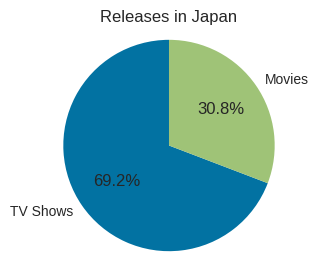

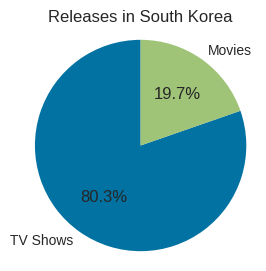

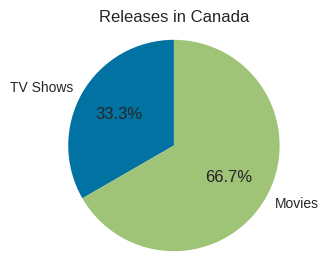

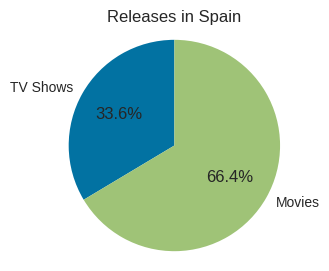

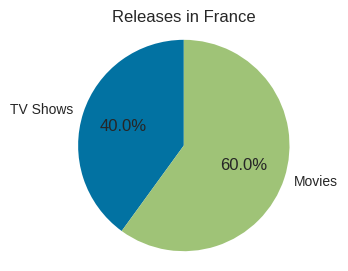

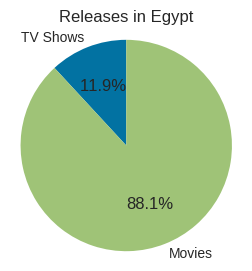

In [ ]:
draw_pie_charts_top_10(df)

##### 1. Why did you pick the specific chart?

A pie chart depicts the portion relationship of your data. The area covered in a circle with different colours makes it easy to see how the percentages compare. this Pie chart to show the percentage of releases as per country

##### 2. What is/are the insight(s) found from the chart?

1. The impact of Bollywood and Hollywood in India and the United States explains the type of content offered, and it appears that the major focus of this industry is films rather than TV shows.
2. TV shows are more common in South Korea, which explains the current KDrama culture.
3. The percentage of TV shows in Japan is also higher, which may be related to the popularity of anime in this country.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

1. Bollywood and Hollywood's impact in India, the United States, and South Korea offers valuable insights for positive business ventures. However, market research, cultural understanding, competition, and consumer preferences must also be considered.
2. Understanding Bollywood and Hollywood's dominance can help businesses tailor offerings to Indian and American audiences, expanding market reach and increasing revenue. Content localization in South Korea and Japan can attract a dedicated fan base, while cultural exchange facilitates cross-cultural collaborations and partnerships, enabling businesses to tap into new markets and diversify content offerings.
3. South Korea and Japan's TV shows have higher prevalence, but assessing demand and viability in other markets is crucial. Market analysis, cultural research, localization, and partnerships with experts mitigate risks and ensure positive reception.

# **Textual Data Preprocessing**

(It's mandatory for textual dataset i.e., NLP, Sentiment Analysis, Text Clustering etc.)

In [ ]:
df['director']=df['director'].apply(lambda x : x.replace(' ',''))
df['cast']=df['cast'].apply(lambda x : x.replace(' ',''))
df['rating']=df['rating'].apply(lambda x : x.replace('-',''))
df['listed_in']=df['listed_in'].apply(lambda x : x.replace(' ',''))

In [ ]:
df['cast']=df['cast'].apply(lambda x : x.replace(',' ,' '))

In [ ]:
#appending all text column to single text column to work with
df['filtered'] = df['description'] + ' ' + df['listed_in'] + ' ' + df['rating'] + ' ' + df['cast'] + ' ' + df['director']

In [ ]:
df['filtered']

0       In a future where the elite inhabit an island ...
1       After a devastating earthquake hits Mexico Cit...
2       When an army recruit is found dead, his fellow...
3       In a postapocalyptic world, rag-doll robots hi...
4       A brilliant group of students become card-coun...
                              ...                        
7782    When Lebanon's Civil War deprives Zozo of his ...
7783    A scrappy but poor boy worms his way into a ty...
7784    In this documentary, South African rapper Nast...
7785    Dessert wizard Adriano Zumbo looks for the nex...
7786    This documentary delves into the mystique behi...
Name: filtered, Length: 7770, dtype: object

#### 1. Expand Contraction

In [ ]:
df['filtered_new'] = df['filtered'].copy()

#### 2. Lower Casing

In [ ]:
# Lower Casing
df['filtered_new' ]= df['filtered_new'].str.lower()

#### 3. Removing Punctuations

In [ ]:
import re
df['filtered_new'] = df['filtered_new'].apply(lambda x: re.sub(r'[^a-zA-Z]', ' ', x))

#### 4. Removing URLs & Removing words and digits contain digits.

In [ ]:
filtered_new_df = df.copy()

for i in range(len(df['filtered_new'])):
    new_com = ''
    try:
        for word in df['filtered_new'][i].split():
            # Remove URLs
            if not word.startswith("http"):
                # Remove words and digits containing digits
                if not bool(re.search(r'\d', word)):
                    new_com += ' ' + word
        filtered_new_df.at[i, 'filtered_new'] = new_com.strip()
    except KeyError:
        pass


#### 5. Removing Stopwords & Removing White spaces

In [ ]:
from nltk.corpus import stopwords
stopwords = set(stopwords.words('english'))

filtered_new_df['filtered_new'] = filtered_new_df['filtered_new'].apply(lambda x: ' '.join([word for word in x.split() if word.lower() not in stopwords]))
filtered_new_df['filtered_new'] = filtered_new_df['filtered_new'].apply(lambda x: ' '.join(x.split()))


#### 6. Rephrase Text

In [ ]:
# Rephrase Text
def rephrase_sentence(sentence):
    return sentence

filtered_new_df['filtered_new'] = filtered_new_df['filtered_new'].apply(lambda x: rephrase_sentence(x))

#### 7. Tokenization

In [ ]:
filtered_new_df['tokenized'] = filtered_new_df['filtered_new'].apply(lambda x: word_tokenize(x))

#### 8. Text Normalization

In [ ]:
from nltk.stem import WordNetLemmatizer

lemmatizer = WordNetLemmatizer()
filtered_new_df['filtered_new'] = filtered_new_df['filtered_new'].apply(lambda x: ' '.join([lemmatizer.lemmatize(word) for word in x.split()]))


In [ ]:
df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year,month_added,seasons,minutes,duration_category,filtered,filtered_new
0,s1,TV Show,3%,Unknown,JoãoMiguel BiancaComparato MichelGomes Rodolfo...,Brazil,2020-08-14,2020,Adults,4 Seasons,"InternationalTVShows,TVDramas,TVSci-Fi&Fantasy",In a future where the elite inhabit an island ...,2020,8,4,NaN,Long TV Show,In a future where the elite inhabit an island ...,in a future where the elite inhabit an island ...
1,s2,Movie,7:19,JorgeMichelGrau,DemiánBichir HéctorBonilla OscarSerrano Azalia...,Mexico,2016-12-23,2016,Adults,93 min,"Dramas,InternationalMovies",After a devastating earthquake hits Mexico Cit...,2016,12,NaN,93,Short Movie,After a devastating earthquake hits Mexico Cit...,after a devastating earthquake hits mexico cit...
2,s3,Movie,23:59,GilbertChan,TeddChan StellaChung HenleyHii LawrenceKoh Tom...,Singapore,2018-12-20,2011,Adults,78 min,"HorrorMovies,InternationalMovies","When an army recruit is found dead, his fellow...",2018,12,NaN,78,Short Movie,"When an army recruit is found dead, his fellow...",when an army recruit is found dead his fellow...
3,s4,Movie,9,ShaneAcker,ElijahWood JohnC.Reilly JenniferConnelly Chris...,United States,2017-11-16,2009,Teens,80 min,"Action&Adventure,IndependentMovies,Sci-Fi&Fantasy","In a postapocalyptic world, rag-doll robots hi...",2017,11,NaN,80,Short Movie,"In a postapocalyptic world, rag-doll robots hi...",in a postapocalyptic world rag doll robots hi...
4,s5,Movie,21,RobertLuketic,JimSturgess KevinSpacey KateBosworth AaronYoo ...,United States,2020-01-01,2008,Teens,123 min,Dramas,A brilliant group of students become card-coun...,2020,1,NaN,123,Long Movie,A brilliant group of students become card-coun...,a brilliant group of students become card coun...


##### Which text normalization technique have you used and why?

 Normalisation methods include eliminating spaces, hyphens, lowercase letters and numbers, non-alphabetic characters, stopwords, and lemmatization. These procedures help in standardising and getting text data ready for other types of analysis, such as text gathering or tasks involving natural language processing. The code lowercases every word, strips out non-alphabetic letters, and eliminates stopwords before concatenating them into a single column labelled "filtered." By reducing words to their dictionary definition, the lemmatization procedure normalises word variants.

#### 9. Part of speech tagging

In [ ]:
# POS Taging
def pos_tagging(text):
    tokens = word_tokenize(text)
    pos_tags = nltk.pos_tag(tokens)
    return pos_tags

# Apply POS Tagging
filtered_new_df['pos_tags'] = filtered_new_df['filtered_new'].apply(lambda x: pos_tagging(x))

# Print POS tags for each row
for index, row in filtered_new_df.iterrows():
    print(f"Row {index + 1} POS tags:")
    print(row['pos_tags'])
    print()

Streaming output truncated to the last 5000 lines.
[('feeling', 'VBG'), ('guilty', 'JJ'), ('high', 'JJ'), ('speed', 'NN'), ('chase', 'NN'), ('leaf', 'JJ'), ('girl', 'NN'), ('dead', 'JJ'), ('determined', 'VBD'), ('sergeant', 'JJ'), ('pursues', 'NNS'), ('crime', 'NN'), ('bos', 'NN'), ('triggered', 'VBD'), ('fatal', 'JJ'), ('car', 'NN'), ('accident', 'NN'), ('action', 'NN'), ('adventure', 'NN'), ('internationalmovies', 'NNS'), ('young', 'JJ'), ('adult', 'VBP'), ('nicholastse', 'JJ'), ('nickcheung', 'NN'), ('zhangjing', 'VBG'), ('chu', 'JJ'), ('miaopu', 'NN'), ('liukai', 'NN'), ('chi', 'NN'), ('philipkeung', 'NN'), ('kwokjing', 'VBG'), ('hung', 'NN'), ('shermanchung', 'NN'), ('zhanghe', 'NN'), ('wongsuet', 'NN'), ('yin', 'NN'), ('wongsum', 'NN'), ('yin', 'NN'), ('dantelam', 'NN')]

Row 6122 POS tags:
[('artistic', 'JJ'), ('pursuit', 'NN'), ('two', 'CD'), ('childhood', 'NN'), ('friend', 'NN'), ('aspiring', 'VBG'), ('singer', 'NN'), ('talented', 'VBD'), ('dancer', 'JJ'), ('lead', 'JJ'), ('fo

#### 10. Text Vectorization

In [ ]:
# Vectorizing Text
t_vectorizer = TfidfVectorizer(max_df=0.8, max_features=10000)
X = t_vectorizer.fit_transform(df['filtered_new'])
X

<7770x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 207273 stored elements in Compressed Sparse Row format>

##### Which text vectorization technique have you used and why?

TF-IDF vectorization is a text analysis approach that gives more importance to words that appear often in a document but are less common in the entire collection. This helps in capturing discriminative power and reduces the significance of common phrases across various papers. The TF-IDF is frequently used for document categorization, clustering, and information retrieval, capturing both local and global term significance in a collection of documents.

# **Dimesionality Reduction**

##### Do you think that dimensionality reduction is needed? Explain Why?

Dimensionality reduction is necessary for high-dimensional areas because it deals with issues such as computing efficiency, noise and redundancy reduction, interpretability, and resource limits. PCA and LSA techniques, for example, minimise noise, redundancy, and memory needs, making analysis more manageable, efficient, and interpretable.

In [ ]:
df.isnull().sum()

show_id                 0
type                    0
title                   0
director                0
cast                    0
country                 0
date_added              0
release_year            0
rating                  0
duration                0
listed_in               0
description             0
year                    0
month_added             0
seasons              5372
minutes              2398
duration_category       0
filtered                0
filtered_new            0
dtype: int64

In [ ]:
# DImensionality Reduction (If needed)
transformer = PCA()
transformer.fit(X.toarray())

PCA()

Text(0, 0.5, 'cumulative explained variance')

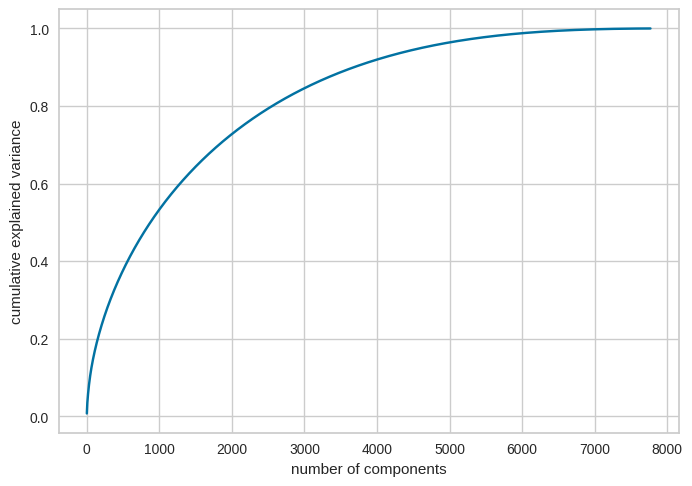

In [ ]:
plt.plot(np.cumsum(transformer.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')


In [ ]:
#choosing right dim from plot, this might take a while, for ready ans use n_components = 4000
from sklearn.decomposition import PCA
transformer = PCA(n_components=4000)
transformer.fit(X.toarray())
X_transformed = transformer.transform(X.toarray())
X_transformed.shape

(7770, 4000)

##### Which dimensionality reduction technique have you used and why? (If dimensionality reduction done on dataset.)

The dimensionality reduction technique used is Principal Component Analysis (PCA). PCA is a widely used technique for dimensionality reduction. It transforms the high-dimensional data into a lower-dimensional representation by identifying and capturing the most important patterns and variances in the data.

In [ ]:
X_vectorized = t_vectorizer.transform(df['filtered_new'])

In [ ]:
X= transformer.transform(X_vectorized.toarray())


In [ ]:
X

array([[ 6.50308127e-02, -5.45993324e-02, -2.13389343e-03, ...,
        -2.88232766e-03, -1.23666902e-02, -4.21309071e-03],
       [-5.53843300e-02,  3.70158151e-03, -1.69195618e-02, ...,
        -8.01393052e-03,  1.25362388e-03,  7.09166671e-03],
       [-9.29790165e-02, -6.61501507e-05, -4.36572302e-02, ...,
         1.08088015e-02, -5.19732086e-03, -2.89720078e-03],
       ...,
       [ 1.45044507e-01,  7.63336046e-02, -5.95368932e-02, ...,
         2.28397896e-03, -2.66834127e-03, -1.93370300e-02],
       [ 1.02458519e-01, -5.04401926e-02,  1.83795384e-02, ...,
         4.00509841e-04,  1.29474220e-02, -6.61735061e-03],
       [ 2.00363732e-01,  3.75811784e-02, -8.83532110e-02, ...,
         3.26418255e-03,  6.20841477e-03,  5.17414674e-03]])

# **ML Model Implementation**

### ML Model - 1

## K-Means Clustering

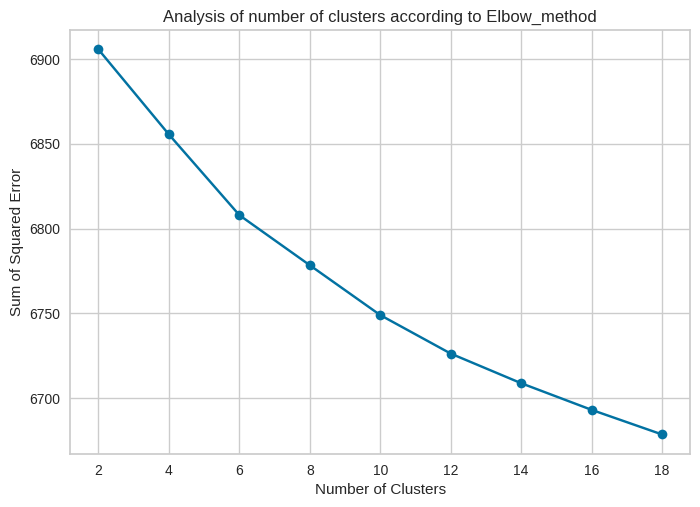

In [ ]:
def optimum_clusters(method_name, features_matrix):
    clusters = range(2, 20, 2)  # Use a step size of 2
    y_axis = []
    early_stop = False

    for i in clusters:
        if early_stop:
            break

        kmeans = KMeans(n_clusters=i, random_state=42)
        kmeans.fit(features_matrix)

        if method_name == 'Elbow_method':
            sse = kmeans.inertia_
            y_axis.append(sse)
            plt.title(f'Analysis of number of clusters according to {method_name}')
            plt.ylabel('Sum of Squared Error')

            # Check early stopping condition
            if len(y_axis) > 2 and y_axis[-1] > y_axis[-2]:
                early_stop = True
        else:
            labels = kmeans.labels_
            silhouette_avg = silhouette_score(features_matrix, labels)
            y_axis.append(silhouette_avg)

            plt.title(f'Analysis of number of clusters according to {method_name}')
            plt.ylabel('Silhouette Score')

    plt.plot(clusters[:len(y_axis)], y_axis, marker='o')
    plt.xlabel('Number of Clusters')
    plt.show()


optimum_clusters('Elbow_method',X_transformed)

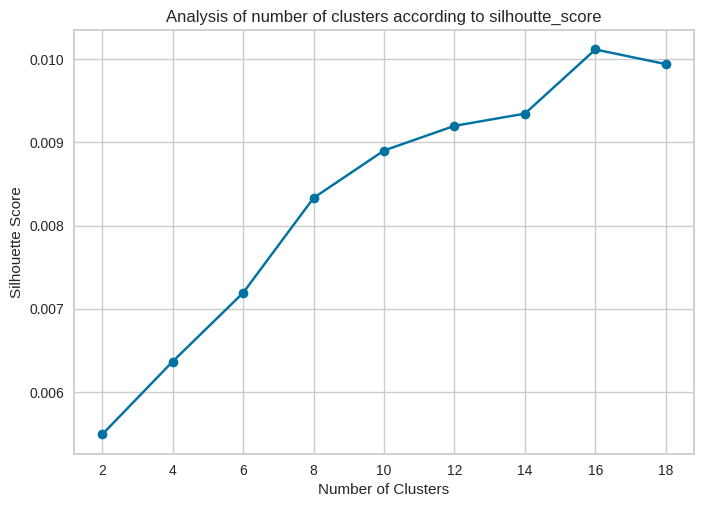

In [ ]:
optimum_clusters('silhoutte_score',X_transformed)


#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

K-means clustering is an unsupervised machine learning approach that uses similarity to divide data into specified groupings. Iteratively, it assigns data points to the closest centroid and updates centroids depending on mean. Although assessing cluster quality is difficult, measurements such as inertia and silhouette score might help.

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.cluster import KMeans

# Define the parameter grid
param_grid = {
    'n_clusters': [3,5,9],
    'random_state': [1,42],
    'init': ['k-means++'],
    'max_iter': [300],
    'n_init': [1]
}

# Create the KMeans instance
kmean = KMeans()

# Create the GridSearchCV instance with reduced cv folds
grid_search = GridSearchCV(estimator=kmean, param_grid=param_grid, cv=3)

# Fit the data to perform the grid search
grid_search.fit(X)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Instantiate KMeans with the best parameters
kmean_best = KMeans(n_clusters=best_params['n_clusters'], random_state=best_params['random_state'])

# Fit the algorithm with the best parameters
kmean_best.fit(X)


KMeans(n_clusters=9, random_state=42)

In [ ]:
#predict the labels of clusters
label = kmean_best.fit_predict(X)

In [ ]:
print("Silhouette Coefficient:  %0.3f"%silhouette_score(X, kmean_best.labels_))

Silhouette Coefficient:  0.009


In [ ]:
# Create a trace for each cluster
u_labels = np.unique(label)
data = []
for i in u_labels:
    data.append(go.Scatter3d(
        x=X[label == i, 0],
        y=X[label == i, 1],
        z=X[label == i, 2],
        mode='markers',
        marker=dict(
            size=5,
            color=i,
            colorscale='Viridis',
            opacity=0.8
        ),
        name='Cluster {}'.format(i)
    ))

# Set layout and create figure
layout = go.Layout(
    title='K-means Clustering Results (3D)',
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z')
    )
)

fig = go.Figure(data=data, layout=layout)
fig.show()


In [ ]:
from sklearn import metrics

# Compute evaluation metrics
silhouette = metrics.silhouette_score(X, label)
calinski_harabasz = metrics.calinski_harabasz_score(X, label)
davies_bouldin = metrics.davies_bouldin_score(X, label)

# Create a dictionary to store the evaluation metrics
evaluation = {
    'Silhouette': silhouette,
    'Calinski-Harabasz': calinski_harabasz,
    'Davies-Bouldin': davies_bouldin
}

# Display the evaluation metrics
print("Silhouette Score: ", silhouette)
print("Calinski-Harabasz Score: ", calinski_harabasz)
print("Davies-Bouldin Score: ", davies_bouldin)



Silhouette Score:  0.008561222920353453
Calinski-Harabasz Score:  26.21353728561443
Davies-Bouldin Score:  10.083497899545666


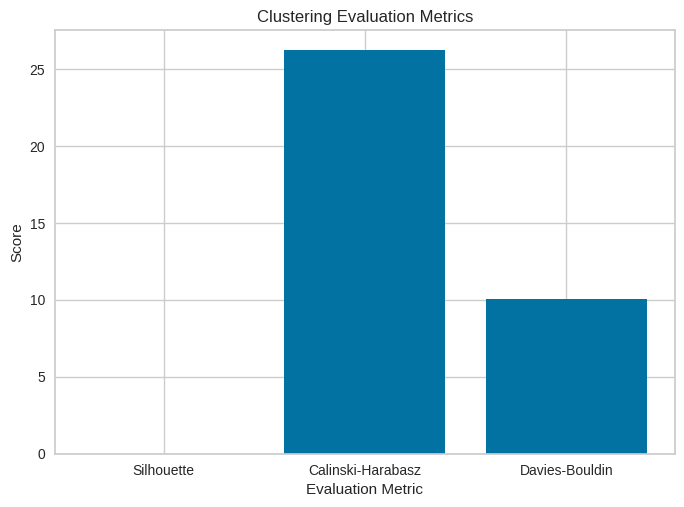

In [ ]:
# Plot the evaluation metrics as a bar chart
plt.bar(evaluation.keys(), evaluation.values())
plt.xlabel('Evaluation Metric')
plt.ylabel('Score')
plt.title('Clustering Evaluation Metrics')
plt.show()

Based on the evaluation metrics, the Calinski-Harabasz score suggests good clustering results with well-separated clusters, while the Silhouette coefficient and Davies-Bouldin index indicate less desirable clustering outcomes with overlapping and dissimilar clusters.

In [ ]:
# kmeans label to cluster column
df['cluster'] = kmean_best.labels_

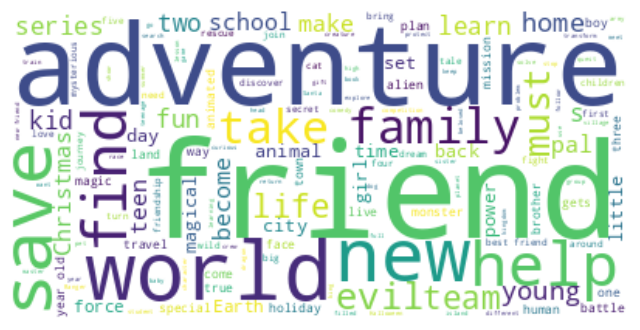

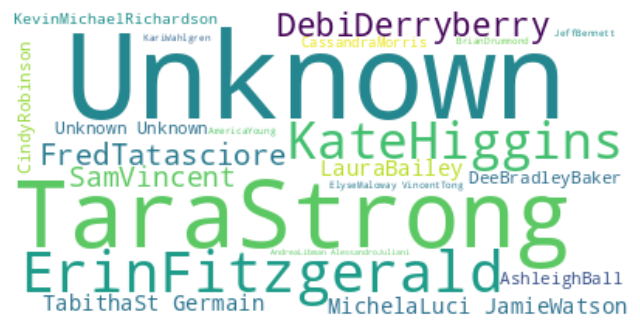

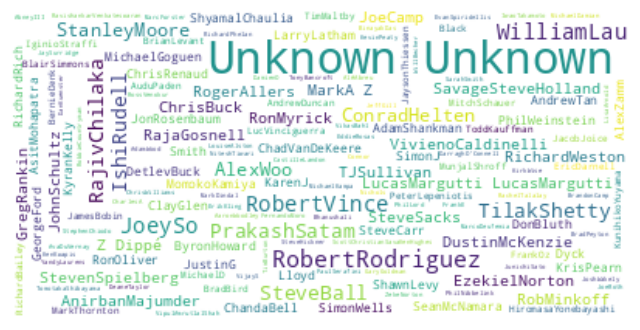

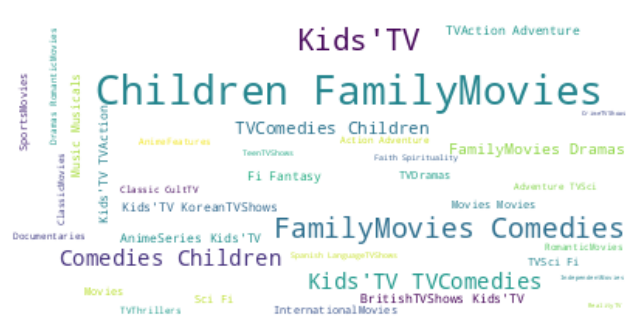

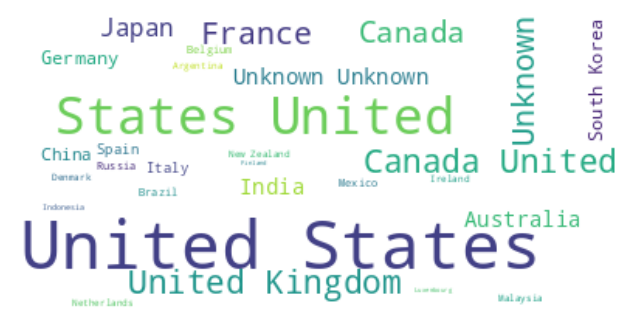

...

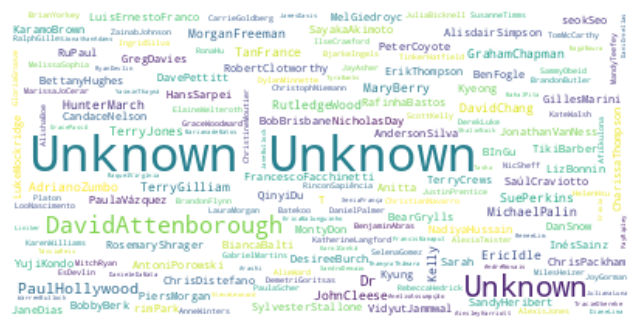

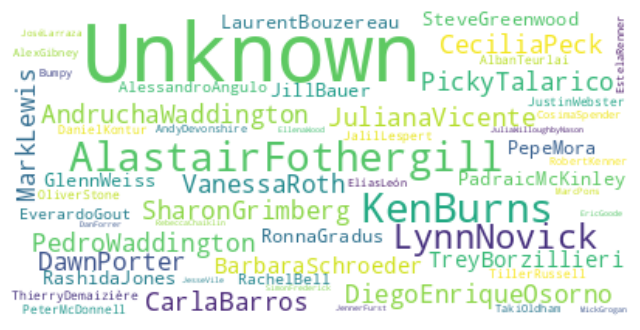

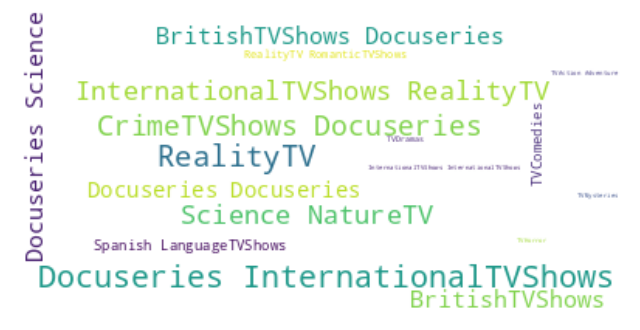

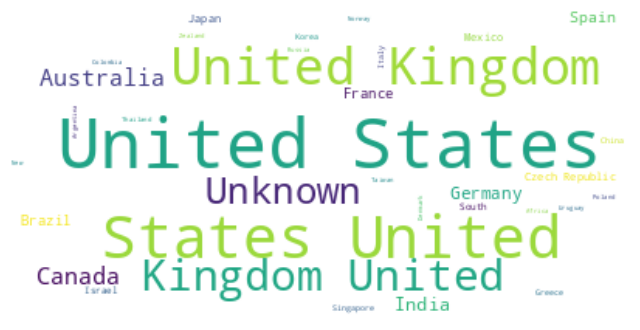

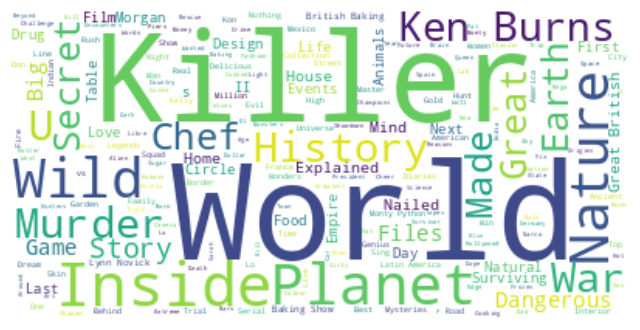

In [ ]:
def generate_word_cloud(category_name, column_of_choice):
    df_word_cloud = df[['cluster', column_of_choice]].dropna()
    df_word_cloud = df_word_cloud[df_word_cloud['cluster'] == category_name]
    text = " ".join(word for word in df_word_cloud[column_of_choice])

    # Create stopword list:
    stopwords = set(STOPWORDS)

    # Generate a word cloud image
    wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)

    # Display the generated image
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

def generate_word_clouds():
    columns = ['description', 'cast', 'director', 'listed_in', 'country', 'title']

    for i in range(9):
        for column in columns:
            generate_word_cloud(i, column)

generate_word_clouds()


In [ ]:
df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year,month_added,seasons,minutes,duration_category,filtered,filtered_new,cluster
0,s1,TV Show,3%,Unknown,JoãoMiguel BiancaComparato MichelGomes Rodolfo...,Brazil,2020-08-14,2020,Adults,4 Seasons,"InternationalTVShows,TVDramas,TVSci-Fi&Fantasy",In a future where the elite inhabit an island ...,2020,8,4,NaN,Long TV Show,In a future where the elite inhabit an island ...,in a future where the elite inhabit an island ...,5
1,s2,Movie,7:19,JorgeMichelGrau,DemiánBichir HéctorBonilla OscarSerrano Azalia...,Mexico,2016-12-23,2016,Adults,93 min,"Dramas,InternationalMovies",After a devastating earthquake hits Mexico Cit...,2016,12,NaN,93,Short Movie,After a devastating earthquake hits Mexico Cit...,after a devastating earthquake hits mexico cit...,7
2,s3,Movie,23:59,GilbertChan,TeddChan StellaChung HenleyHii LawrenceKoh Tom...,Singapore,2018-12-20,2011,Adults,78 min,"HorrorMovies,InternationalMovies","When an army recruit is found dead, his fellow...",2018,12,NaN,78,Short Movie,"When an army recruit is found dead, his fellow...",when an army recruit is found dead his fellow...,7
3,s4,Movie,9,ShaneAcker,ElijahWood JohnC.Reilly JenniferConnelly Chris...,United States,2017-11-16,2009,Teens,80 min,"Action&Adventure,IndependentMovies,Sci-Fi&Fantasy","In a postapocalyptic world, rag-doll robots hi...",2017,11,NaN,80,Short Movie,"In a postapocalyptic world, rag-doll robots hi...",in a postapocalyptic world rag doll robots hi...,1
4,s5,Movie,21,RobertLuketic,JimSturgess KevinSpacey KateBosworth AaronYoo ...,United States,2020-01-01,2008,Teens,123 min,Dramas,A brilliant group of students become card-coun...,2020,1,NaN,123,Long Movie,A brilliant group of students become card-coun...,a brilliant group of students become card coun...,7


##### Which hyperparameter optimization technique have you used and why?

GridSearchCV is a hyperparameter optimization technique that searches a grid for optimal hyperparameter combinations using cross-validation. GridSearchCV optimizes hyperparameters for optimal K-means clustering performance by evaluating combinations and cross-validation, ensuring generalizability and optimal clustering results. We conclude that the optimum number for n_cluster is 9 and the greatest value for random_state is 42.

In [ ]:
def create_cluster_wordcloud(df, cluster_number):
    cluster_df = df[df['cluster'] == cluster_number]
    text = ' '.join(cluster_df['description'].dropna())

    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Cluster {cluster_number}')
    plt.axis('off')
    plt.show()


In [ ]:
df['cluster'].unique()

array([5, 7, 1, 3, 8, 4, 6, 0, 2], dtype=int32)

### kids'TV, Children and Family Movies

In [ ]:
df[df['cluster'] == 0][['type','title','director','cast','country','rating','listed_in','description']]


,type,title,director,cast,country,rating,listed_in,description
55,Movie,100 Things to do Before High School,Unknown,IsabelaMoner JaheemToombs OwenJoyner JackDeSen...,United States,Kids,Movies,"Led by seventh-grader C.J., three students who..."
108,TV Show,3Below: Tales of Arcadia,Unknown,TatianaMaslany DiegoLuna NickOfferman NickFros...,United States,Teens,"Kids'TV,TVAction&Adventure,TVSci-Fi&Fantasy","After crash-landing on Earth, two royal teen a..."
111,TV Show,44 Cats,Unknown,SarahNatochenny SuzyMyers SimonaBerman EricaSc...,Italy,Teens,Kids'TV,Paw-esome tales abound when singing furry frie...
113,Movie,48 Christmas Wishes,"MarcoDeufemia,JustinG.Dyck",KhiylaAynne NoahDyer MayaFranzoi ClaraKushnir ...,Canada,Kids,"Children&FamilyMovies,Comedies",When a small town's letters to Santa accidenta...
145,Movie,A 2nd Chance,ClayGlen,NinaPearce AdamTuominen EmilyMorris AmyHandley...,Australia,Kids,"Children&FamilyMovies,Dramas,SportsMovies",A gymnast lacks the confidence she needs to re...
...,...,...,...,...,...,...,...,...
7772,Movie,Zipi & Zape y la Isla del Capitan,OskarSantos,TeoPlanell ToniGómez ElenaAnaya IriaCastellano...,Spain,Kids,"Children&FamilyMovies,Comedies","At Christmas, Zip and Zap take a trip with the..."
7775,TV Show,Zoids Wild,Unknown,KenshoOno TakahiroSakurai MikakoKomatsu Etsuko...,Japan,Teens,"AnimeSeries,Kids'TV",A quest for freedom and legendary treasure beg...
7776,Movie,Zokkomon,SatyajitBhatkal,DarsheelSafary AnupamKher ManjariFadnis TinnuA...,India,Kids,"Children&FamilyMovies,Dramas","When his cruel uncle abandons him, a young orp..."
7777,TV Show,Zombie Dumb,Unknown,Unknown,Unknown,Teens,"Kids'TV,KoreanTVShows,TVComedies","While living alone in a spooky town, a young g..."


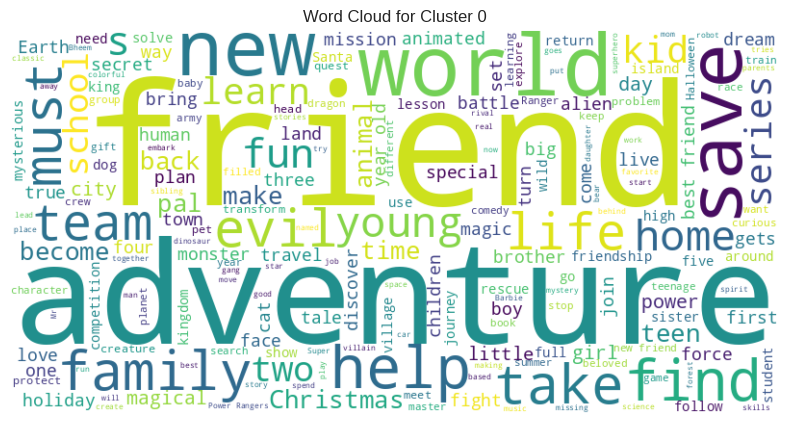

In [ ]:
create_cluster_wordcloud(df, 0)

### Action and Adventures, Sci-FI and Fantasy

In [ ]:
df[df['cluster'] == 1][['type','title','director','cast','country','rating','listed_in','description']]


,type,title,director,cast,country,rating,listed_in,description
3,Movie,9,ShaneAcker,ElijahWood JohnC.Reilly JenniferConnelly Chris...,United States,Teens,"Action&Adventure,IndependentMovies,Sci-Fi&Fantasy","In a postapocalyptic world, rag-doll robots hi..."
21,Movie,​Goli Soda 2,VijayMilton,Samuthirakani BharathSeeni Vinoth EsakkiBarath...,India,Young Adults,"Action&Adventure,Dramas,InternationalMovies","A taxi driver, a gangster and an athlete strug..."
44,Movie,Æon Flux,KarynKusama,CharlizeTheron MartonCsokas JonnyLeeMiller Sop...,United States,Teens,"Action&Adventure,Sci-Fi&Fantasy","Aiming to hasten an uprising, the leader of an..."
50,Movie,"10,000 B.C.",RolandEmmerich,StevenStrait CamillaBelle CliffCurtis JoelVirg...,"United States, South Africa",Teens,Action&Adventure,Fierce mammoth hunter D'Leh sets out on an imp...
68,Movie,14 Blades,DanielLee,DonnieYen ZhaoWei WuChun LawKar-Ying KateTsui ...,"Hong Kong, China, Singapore",Adults,"Action&Adventure,InternationalMovies","In the age of the Ming Dynasty, Quinglong is t..."
...,...,...,...,...,...,...,...,...
7689,Movie,XXX: State of the Union,LeeTamahori,IceCube SamuelL.Jackson WillemDafoe ScottSpeed...,United States,Teens,Action&Adventure,"In this action-packed follow-up to XXX, U.S. i..."
7696,Movie,Yamla Pagla Deewana 2,SangeethSivan,Dharmendra SunnyDeol BobbyDeol NehaSharma Kris...,India,Young Adults,"Action&Adventure,Comedies,InternationalMovies","Up to his old tricks, con man Dharam poses as ..."
7728,Movie,You Don't Mess with the Zohan,DennisDugan,AdamSandler JohnTurturro EmmanuelleChriqui Nic...,United States,Adults,"Action&Adventure,Comedies",An Israeli counterterrorism soldier with a sec...
7737,Movie,Young Tiger,MuChu,QiuYuen CharlieChin JackieChan HuChin NanChiang,Hong Kong,Adults,"Action&Adventure,InternationalMovies","Aided only by a tough female police officer, a..."


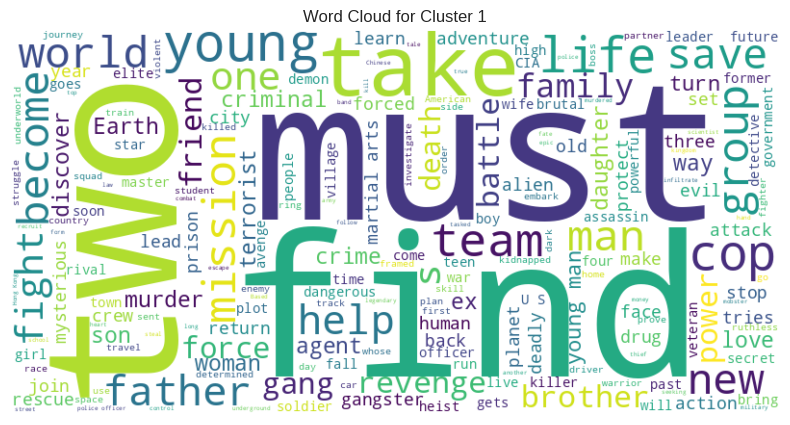

In [ ]:
create_cluster_wordcloud(df, 1)

### Stand-Up Comedy Show, International, India

In [ ]:
df[df['cluster'] == 2][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
220,Movie,A Russell Peters Christmas,HenrySarwer-Foner,RussellPeters PamelaAnderson MichaelBublé JonL...,Canada,Adults,Stand-UpComedy,"Inspired by the variety shows of the 1970s, ""A..."
284,TV Show,Abnormal Summit,"Jung-ahIm,Seung-ukJo",Hyun-mooJun Si-kyungSung Se-yoonYoo,South Korea,Kids,"InternationalTVShows,KoreanTVShows,Stand-UpCom...","Led by a trio of Korean celebs, a multinationa..."
305,Movie,Adam Devine: Best Time of Our Lives,JayKaras,AdamDevine,United States,Adults,Stand-UpComedy,Frenetic comic Adam Devine talks teen awkwardn...
307,Movie,ADAM SANDLER 100% FRESH,SteveBrill,AdamSandler,United States,Adults,Stand-UpComedy,"From ""Heroes"" to ""Ice Cream Ladies"" – Adam San..."
310,Movie,Adel Karam: Live from Beirut,Unknown,AdelKaram,United States,Adults,Stand-UpComedy,"From Casino du Liban, Lebanese actor and comed..."
...,...,...,...,...,...,...,...,...
7718,Movie,Yoo Byung Jae: Discomfort Zone,Y.JoonChung,YooByungJae,South Korea,Adults,Stand-UpComedy,Daring comedian Yoo Byung-jae connects critici...
7719,Movie,Yoo Byung Jae: Too Much Information,YooByung-jae,YooByung-jae,Unknown,Adults,Stand-UpComedy,"""Saturday Night Live Korea"" writer-turned-come..."
7744,Movie,"Yours Sincerely, Kanan Gill",NevilleShah,KananGill,India,Adults,Stand-UpComedy,Revisiting life goals set in a letter written ...
7757,Movie,Zach Galifianakis: Live at the Purple Onion,MichaelBlieden,ZachGalifianakis BrianUnger,United States,Adults,Stand-UpComedy,"The unorthodox, piano-playing stand-up star Za..."


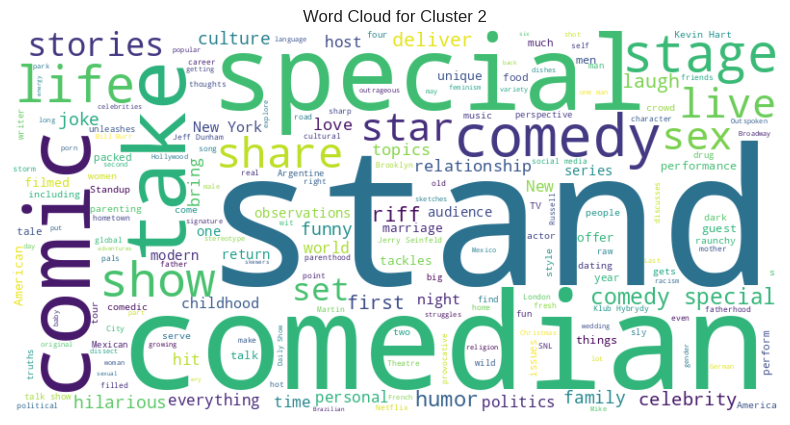

In [ ]:
create_cluster_wordcloud(df, 2)

### Thrillers, International Movies, Dramas

In [ ]:
df[df['cluster'] == 3][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
7,Movie,187,KevinReynolds,SamuelL.Jackson JohnHeard KellyRowan CliftonCo...,United States,Adults,Dramas,After one of his high school students attacks ...
8,Movie,706,ShravanKumar,DivyaDutta AtulKulkarni MohanAgashe AnupamShya...,India,Young Adults,"HorrorMovies,InternationalMovies","When a doctor goes missing, his psychiatrist w..."
9,Movie,1920,VikramBhatt,RajneeshDuggal AdahSharma IndraneilSengupta An...,India,Adults,"HorrorMovies,InternationalMovies,Thrillers",An architect and his wife move into a castle t...
10,Movie,1922,ZakHilditch,ThomasJane MollyParker DylanSchmid KaitlynBern...,United States,Adults,"Dramas,Thrillers",A farmer pens a confession admitting to his wi...
22,Movie,​Maj Rati ​​Keteki,SantwanaBardoloi,AdilHussain ShakilImtiaz MahendraRabha Sulaksh...,India,Young Adults,"Dramas,InternationalMovies",A successful writer returns to the town that l...
...,...,...,...,...,...,...,...,...
7764,Movie,Zero,AanandRai,ShahRukhKhan AnushkaSharma KatrinaKaif Mohamme...,India,Young Adults,"Comedies,Dramas,InternationalMovies",Through his relationships with two wildly diff...
7765,Movie,Zero Hour,RobertO.Peters,RichardMofe-Damijo AlexEkubo AliNuhu RahamaSad...,Unknown,Adults,"InternationalMovies,Thrillers","After his father passes, the heir to a retail ..."
7780,Movie,Zoo,ShlokSharma,ShashankArora ShwetaTripathi RahulKumar GopalK...,India,Adults,"Dramas,IndependentMovies,InternationalMovies",A drug dealer starts having doubts about his t...
7782,Movie,Zozo,JosefFares,ImadCreidi AntoinetteTurk EliasGergi CarmenLeb...,"Sweden, Czech Republic, United Kingdom, Denmar...",Adults,"Dramas,InternationalMovies",When Lebanon's Civil War deprives Zozo of his ...


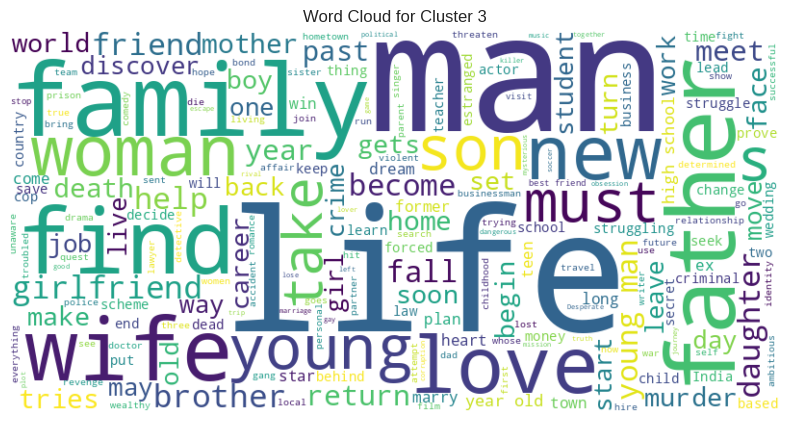

In [ ]:
create_cluster_wordcloud(df, 3)

### Documentaries, Sports, International, Music and Musicals

In [ ]:
df[df['cluster'] == 4][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
13,Movie,"2,215",NottaponBoonprakob,ArtiwaraKongmalai,Thailand,Adults,"Documentaries,InternationalMovies,SportsMovies",This intimate documentary follows rock star Ar...
19,Movie,'89,Unknown,LeeDixon IanWright PaulMerson,United Kingdom,Kids,SportsMovies,"Mixing old footage with interviews, this is th..."
25,Movie,(T)ERROR,"LyricR.Cabral,DavidFelixSutcliffe",Unknown,United States,Adults,Documentaries,This real-life look at FBI counterterrorism op...
28,Movie,#AnneFrank - Parallel Stories,"SabinaFedeli,AnnaMigotto",HelenMirren GengherGatti,Italy,Young Adults,"Documentaries,InternationalMovies","Through her diary, Anne Frank's story is retol..."
30,Movie,#cats_the_mewvie,MichaelMargolis,Unknown,Canada,Young Adults,"Documentaries,InternationalMovies",This pawesome documentary explores how our fel...
...,...,...,...,...,...,...,...,...
7692,Movie,Ya no estoy aquí: Una conversación entre Guill...,Unknown,GuillermodelToro AlfonsoCuarón,Unknown,Kids,Documentaries,Guillermo del Toro and Alfonso Cuarón discuss ...
7771,Movie,Zion,FloydRuss,ZionClark,United States,Kids,"Documentaries,SportsMovies",Born without legs and stuck in foster care for...
7773,Movie,Zoé: Panoramas,"RodrigoGuardiola,GabrielCruzRivas",SergioAcosta JesúsBáez ÁngelMosqueda RodrigoGu...,Mexico,Adults,"Documentaries,InternationalMovies,Music&Musicals",This introspective rockumentary follows the ca...
7784,Movie,Zulu Man in Japan,Unknown,NastyC,Unknown,Adults,"Documentaries,InternationalMovies,Music&Musicals","In this documentary, South African rapper Nast..."


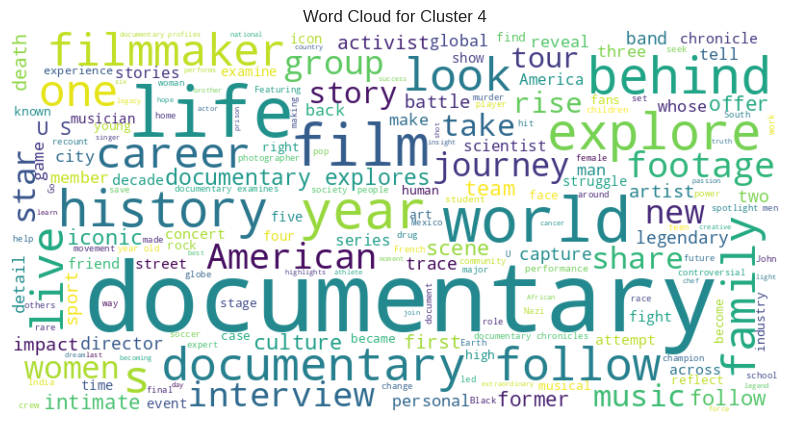

In [ ]:
create_cluster_wordcloud(df, 4)

### Internation TV Shows, TVDrama, Reality TV

In [ ]:
df[df['cluster'] == 5][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
0,TV Show,3%,Unknown,JoãoMiguel BiancaComparato MichelGomes Rodolfo...,Brazil,Adults,"InternationalTVShows,TVDramas,TVSci-Fi&Fantasy",In a future where the elite inhabit an island ...
5,TV Show,46,SerdarAkar,ErdalBeşikçioğlu YaseminAllen MelisBirkan Sayg...,Turkey,Adults,"InternationalTVShows,TVDramas,TVMysteries",A genetics professor experiments with a treatm...
11,TV Show,1983,Unknown,RobertWięckiewicz MaciejMusiał MichalinaOlszań...,"Poland, United States",Adults,"CrimeTVShows,InternationalTVShows,TVDramas","In this dark alt-history thriller, a naïve law..."
16,TV Show,Feb-09,Unknown,ShahdElYaseen ShailaSabt Hala HanadiAl-Kandari...,Unknown,Young Adults,"InternationalTVShows,TVDramas","As a psychology professor faces Alzheimer's, h..."
24,TV Show,​SAINT SEIYA: Knights of the Zodiac,Unknown,BrysonBaugus EmilyNeves BlakeShepard PatrickPo...,Japan,Young Adults,"AnimeSeries,InternationalTVShows",Seiya and the Knights of the Zodiac rise again...
...,...,...,...,...,...,...,...,...
7743,TV Show,Yours Fatefully,Unknown,KingoneWang JessecaLiu XiangYun ChenShucheng E...,Singapore,Young Adults,"InternationalTVShows,RomanticTVShows,TVComedies",Two lonely singles meet on a blind date and sl...
7746,TV Show,دفعة القاهرة,Unknown,Basharal-Shatti FatimaAlSafi MaramBalochi Hama...,Unknown,Young Adults,"InternationalTVShows,TVDramas",A group of women leaves Kuwait to attend unive...
7752,TV Show,Yummy Mummies,Unknown,LorinskaMerrington JaneScandizzo RachelWatts M...,Australia,Adults,"InternationalTVShows,RealityTV",It's drama Down Under when expectant mothers w...
7753,TV Show,Yunus Emre,Unknown,GökhanAtalay PayidarTüfekçioglu BaranAkbulut M...,Turkey,Kids,"InternationalTVShows,TVDramas","During the Mongol invasions, Yunus Emre leaves..."


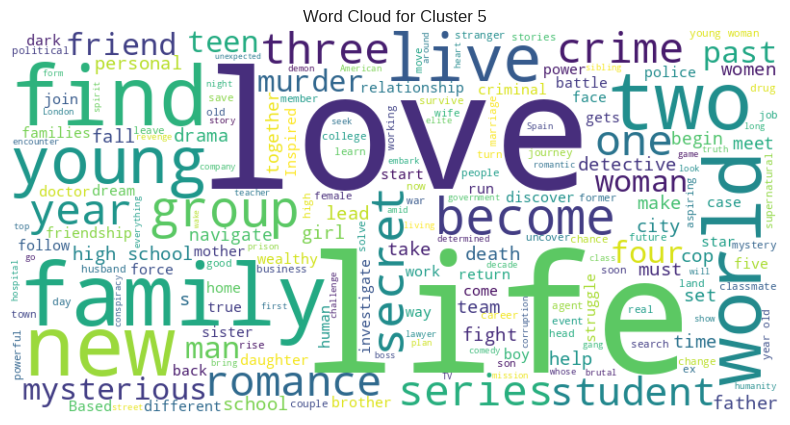

In [ ]:
create_cluster_wordcloud(df, 5)

### Comedies, Romantic Movies

In [ ]:
df[df['cluster'] == 6][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
33,Movie,#realityhigh,FernandoLebrija,NestaCooper KateWalsh JohnMichaelHiggins Keith...,United States,Young Adults,Comedies,When nerdy high schooler Dani finally attracts...
39,Movie,"¡Ay, mi madre!",FrankAriza,EstefaníadelosSantos SecundelaRosa TerelePávez...,Spain,Adults,"Comedies,InternationalMovies","When her estranged mother suddenly dies, a wom..."
46,Movie,1 Chance 2 Dance,AdamDeyoe,LexiGiovagnoli JustinRay RaeLatt PoonamBasu Te...,United States,Kids,"Dramas,RomanticMovies",When an aspiring dancer is uprooted during her...
57,Movie,100% Halal,JastisArimba,AnisaRahma AriyoWahab AnanditoDwis FitriaRasyi...,Indonesia,Young Adults,"Dramas,InternationalMovies","After high school, a young woman marries the m..."
61,TV Show,12 Years Promise,Unknown,So-yeonLee NamkoongMin Tae-imLee So-huiYoon Wo...,South Korea,Young Adults,"InternationalTVShows,KoreanTVShows,RomanticTVS...",A pregnant teen is forced by her family to lea...
...,...,...,...,...,...,...,...,...
7723,Movie,You Can Tutu,JamesBrown,LilyO'Regan JeannettsyEnriquezBorges JoeleyGib...,United Kingdom,Kids,Children&FamilyMovies,A gifted young ballet dancer struggles to find...
7725,TV Show,You Cannot Hide,Unknown,BlancaSoto EduardoNoriega IvánSánchez MaribelV...,Mexico,Adults,"CrimeTVShows,InternationalTVShows,Spanish-Lang...",A nurse and her daughter flee her husband’s dr...
7736,Movie,Young Adult,JasonReitman,CharlizeTheron PattonOswalt PatrickWilson Eliz...,United States,Adults,"Comedies,Dramas,IndependentMovies",When a divorced writer gets a letter from an o...
7760,Movie,Zaki Chan,WaelIhsan,AhmedHelmy YasminAbdulaziz HassanHosny HasanKami,Egypt,Kids,"Comedies,InternationalMovies,RomanticMovies",An unqualified young man has his work cut out ...


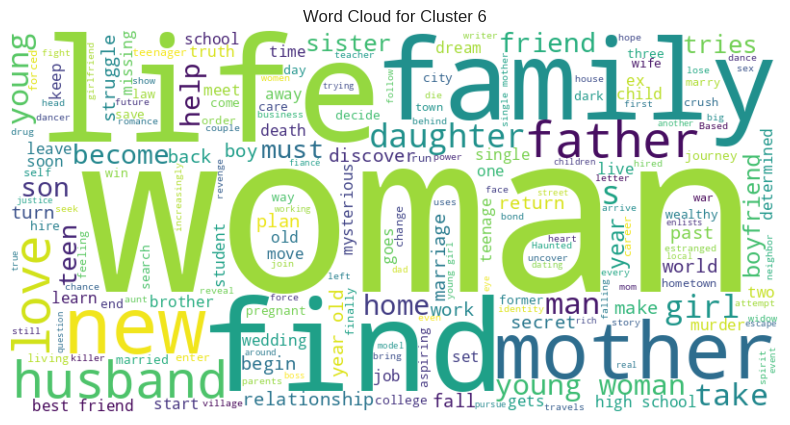

In [ ]:
create_cluster_wordcloud(df, 6)

### Drama, Horror, International, India

In [ ]:
df[df['cluster'] == 7][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
1,Movie,7:19,JorgeMichelGrau,DemiánBichir HéctorBonilla OscarSerrano Azalia...,Mexico,Adults,"Dramas,InternationalMovies",After a devastating earthquake hits Mexico Cit...
2,Movie,23:59,GilbertChan,TeddChan StellaChung HenleyHii LawrenceKoh Tom...,Singapore,Adults,"HorrorMovies,InternationalMovies","When an army recruit is found dead, his fellow..."
4,Movie,21,RobertLuketic,JimSturgess KevinSpacey KateBosworth AaronYoo ...,United States,Teens,Dramas,A brilliant group of students become card-coun...
6,Movie,122,YasirAlYasiri,AminaKhalil AhmedDawood TarekLotfy AhmedElFish...,Egypt,Adults,"HorrorMovies,InternationalMovies","After an awful accident, a couple admitted to ..."
14,Movie,3022,JohnSuits,OmarEpps KateWalsh MirandaCosgrove AngusMacfad...,United States,Adults,"IndependentMovies,Sci-Fi&Fantasy,Thrillers",Stranded when the Earth is suddenly destroyed ...
...,...,...,...,...,...,...,...,...
7768,Movie,Zindagi Kitni Haseen Hay,AnjumShahzad,FerozeKhan SajalAli JibraylAhmedRajput AlyyKha...,Pakistan,Young Adults,"Dramas,InternationalMovies,RomanticMovies",Two young parents struggle to keep their marri...
7769,Movie,Zindagi Na Milegi Dobara,ZoyaAkhtar,HrithikRoshan AbhayDeol FarhanAkhtar KatrinaKa...,India,Young Adults,"Comedies,Dramas,InternationalMovies",Three friends on an adventurous road trip/bach...
7770,Movie,Zinzana,MajidAlAnsari,AliSuliman SalehBakri Yasa AliAl-Jabri Mansoor...,"United Arab Emirates, Jordan",Adults,"Dramas,InternationalMovies,Thrillers",Recovering alcoholic Talal wakes up inside a s...
7774,Movie,Zodiac,DavidFincher,MarkRuffalo JakeGyllenhaal RobertDowneyJr. Ant...,United States,Adults,"CultMovies,Dramas,Thrillers","A political cartoonist, a crime reporter and a..."


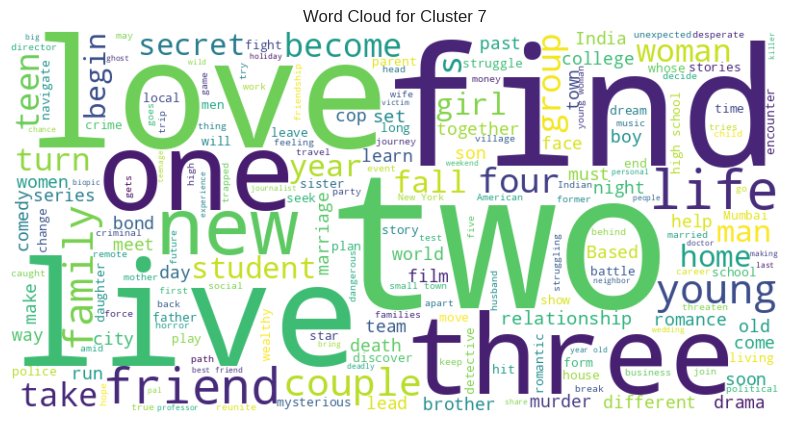

In [ ]:
create_cluster_wordcloud(df, 7)

### Docuseries, Reality TV, Crime TV

In [ ]:
df[df['cluster'] == 8][['type','title','director','cast','country','rating','listed_in','description']]

,type,title,director,cast,country,rating,listed_in,description
12,TV Show,1994,DiegoEnriqueOsorno,Unknown,Mexico,Adults,"CrimeTVShows,Docuseries,InternationalTVShows",Archival video and new interviews examine Mexi...
26,TV Show,(Un)Well,Unknown,Unknown,United States,Adults,RealityTV,This docuseries takes a deep dive into the luc...
53,TV Show,100 Humans,Unknown,ZainabJohnson SammyObeid AlieWard,United States,Young Adults,"Docuseries,Science&NatureTV",One hundred hardy souls from diverse backgroun...
58,TV Show,100% Hotter,Unknown,DanielPalmer MelissaSophia KarenWilliams Grace...,United Kingdom,Young Adults,"BritishTVShows,InternationalTVShows,RealityTV","A stylist, a hair designer and a makeup artist..."
64,TV Show,13 Reasons Why: Beyond the Reasons,Unknown,DylanMinnette KatherineLangford KateWalsh Dere...,United States,Adults,"CrimeTVShows,Docuseries","Cast members, writers, producers and mental he..."
...,...,...,...,...,...,...,...,...
7670,TV Show,World's Most Wanted,Unknown,Unknown,United States,Young Adults,"CrimeTVShows,Docuseries,InternationalTVShows","Suspected of heinous crimes, they’ve avoided c..."
7672,TV Show,Wormwood,Unknown,PeterSarsgaard MollyParker ChristianCamargo Sc...,United States,Young Adults,"CrimeTVShows,Docuseries","In this genre-bending tale, Errol Morris explo..."
7678,TV Show,WWII in HD,Unknown,GarySinise RobLowe JoshLucas JustinBartha AmyS...,United States,Young Adults,Docuseries,Rare color footage interwoven with firsthand i...
7730,TV Show,You vs. Wild,Unknown,BearGrylls,United States,Kids,"Kids'TV,RealityTV,Science&NatureTV","In this interactive series, you'll make key de..."


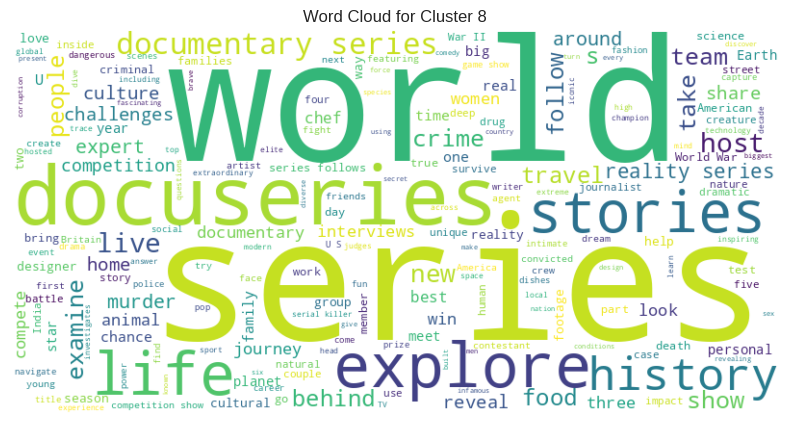

In [ ]:
create_cluster_wordcloud(df, 8)

### ML Model - 2

## Hierarchical clustering

In [ ]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import make_scorer

# Define the parameter grid
param_grid = {
    'n_clusters': [2, 3, 4]  # specify the different values of n_clusters
}

# Create the AgglomerativeClustering instance
clustering = AgglomerativeClustering()

# Create the GridSearchCV instance with silhouette score as the scoring metric
grid_search = GridSearchCV(estimator=clustering, param_grid=param_grid, cv=3,
                           scoring=make_scorer(silhouette_score))

# Fit the data to perform the grid search
grid_search.fit(X_transformed)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Instantiate AgglomerativeClustering with the best parameters
clustering_best = AgglomerativeClustering(n_clusters=best_params['n_clusters'])

# Fit the clustering model with the best parameters
clustering_best.fit(X_transformed)

# Get the cluster labels for each data point
labels = clustering_best.labels_


In [ ]:
# Assigning the clusters to their datapoints.
df['Agglo_clusters']= labels
df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,...,description,year,month_added,seasons,minutes,duration_category,filtered,filtered_new,cluster,Agglo_clusters
0,s1,TV Show,3%,Unknown,JoãoMiguel BiancaComparato MichelGomes Rodolfo...,Brazil,2020-08-14,2020,Adults,4 Seasons,...,In a future where the elite inhabit an island ...,2020,8,4,NaN,Long TV Show,In a future where the elite inhabit an island ...,in a future where the elite inhabit an island ...,5,0
1,s2,Movie,7:19,JorgeMichelGrau,DemiánBichir HéctorBonilla OscarSerrano Azalia...,Mexico,2016-12-23,2016,Adults,93 min,...,After a devastating earthquake hits Mexico Cit...,2016,12,NaN,93,Short Movie,After a devastating earthquake hits Mexico Cit...,after a devastating earthquake hits mexico cit...,7,0
2,s3,Movie,23:59,GilbertChan,TeddChan StellaChung HenleyHii LawrenceKoh Tom...,Singapore,2018-12-20,2011,Adults,78 min,...,"When an army recruit is found dead, his fellow...",2018,12,NaN,78,Short Movie,"When an army recruit is found dead, his fellow...",when an army recruit is found dead his fellow...,7,0
3,s4,Movie,9,ShaneAcker,ElijahWood JohnC.Reilly JenniferConnelly Chris...,United States,2017-11-16,2009,Teens,80 min,...,"In a postapocalyptic world, rag-doll robots hi...",2017,11,NaN,80,Short Movie,"In a postapocalyptic world, rag-doll robots hi...",in a postapocalyptic world rag doll robots hi...,1,0
4,s5,Movie,21,RobertLuketic,JimSturgess KevinSpacey KateBosworth AaronYoo ...,United States,2020-01-01,2008,Teens,123 min,...,A brilliant group of students become card-coun...,2020,1,NaN,123,Long Movie,A brilliant group of students become card-coun...,a brilliant group of students become card coun...,7,0


In [ ]:
df['Agglo_clusters'].value_counts()

0    7398
1     372
Name: Agglo_clusters, dtype: int64

In [ ]:
df['Agglo_clusters'].unique()

array([0, 1])

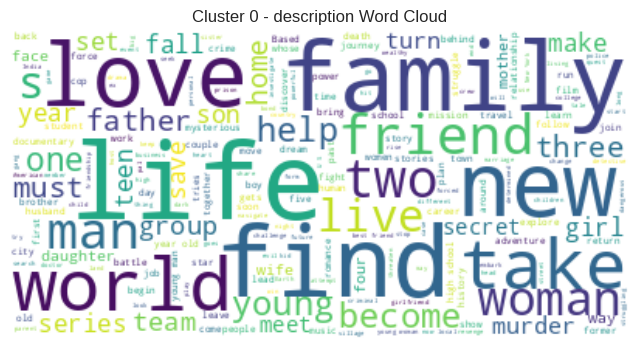

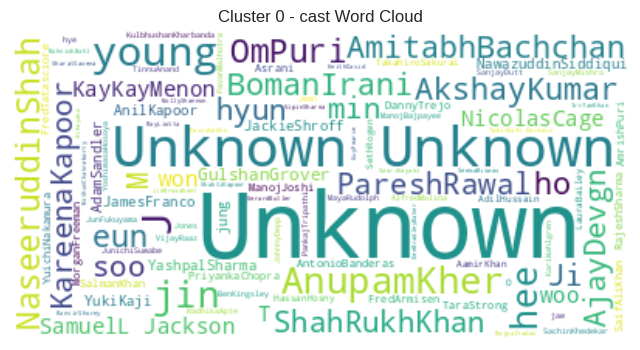

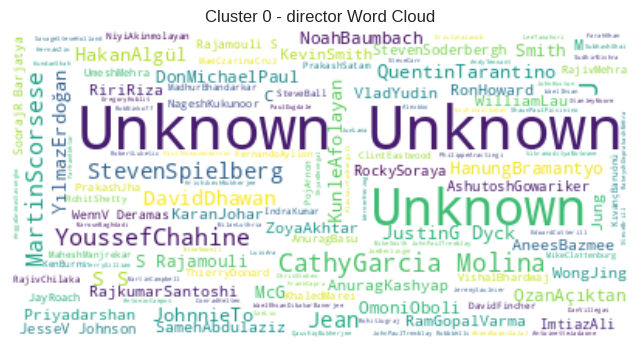

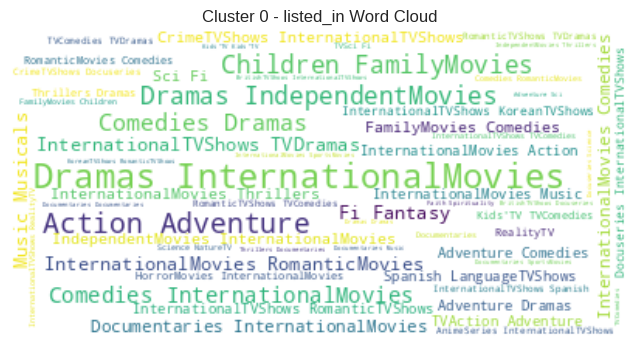

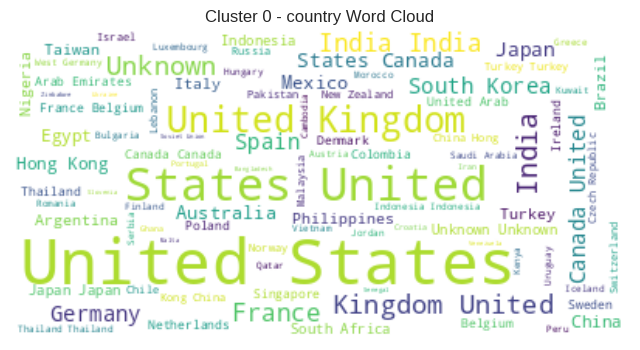

...

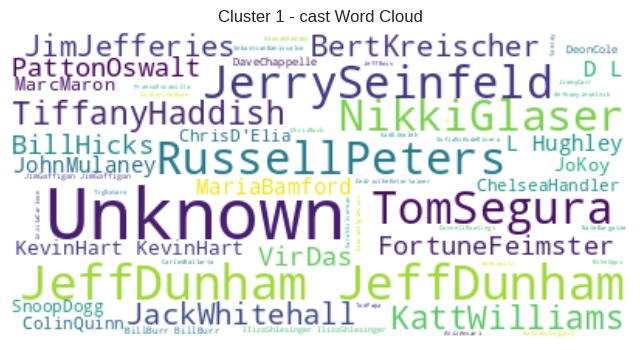

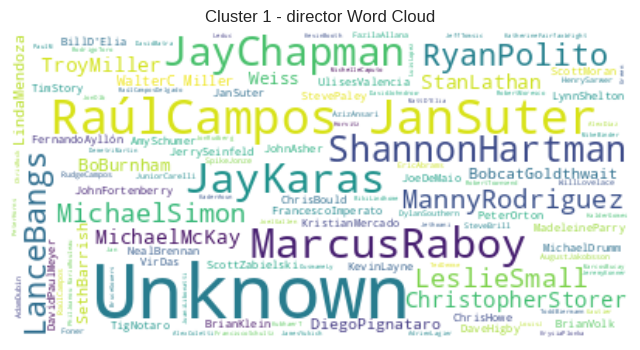

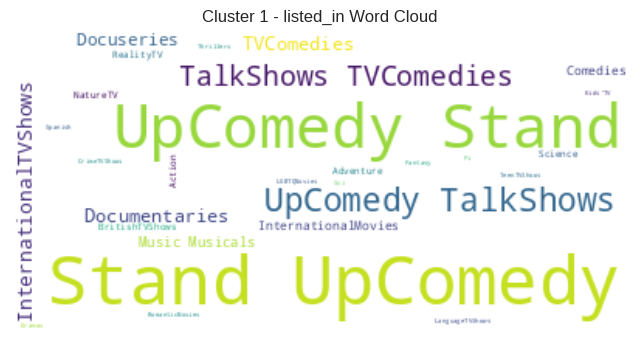

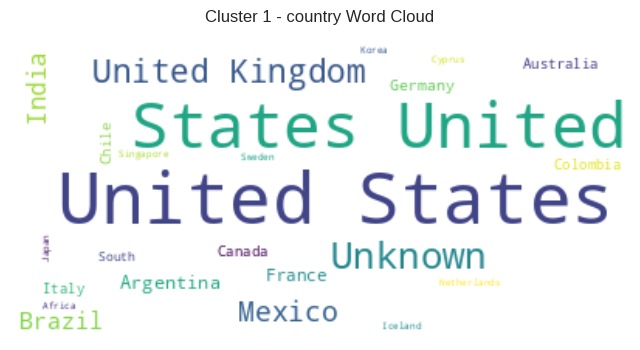

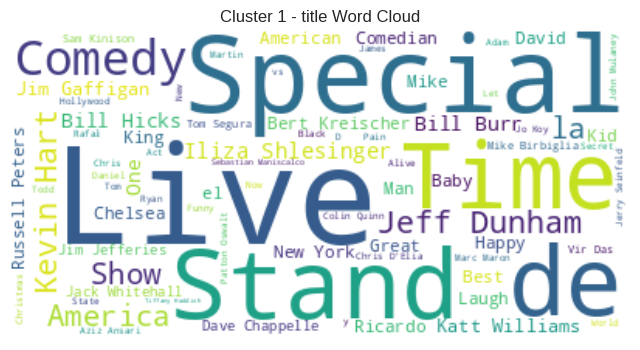

In [ ]:
# Function to generate word cloud for a specific cluster and column
def generate_wordcloud(cluster, column):
    # Filter the dataframe for the specific cluster
    df_cluster = df[df['Agglo_clusters'] == cluster]

    # Concatenate the text from the selected column
    text = " ".join(word for word in df_cluster[column])

    # Create stopword list
    stopwords = set(STOPWORDS)

    # Generate the word cloud
    wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)

    # Display the word cloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Cluster {cluster} - {column} Word Cloud")
    plt.show()

# Generate word clouds for each cluster and column
clusters = df['Agglo_clusters'].unique()
columns = ['description', 'cast', 'director', 'listed_in', 'country', 'title']

for cluster in clusters:
    for column in columns:
        generate_wordcloud(cluster, column)


In [ ]:
u_labels = np.unique(df['Agglo_clusters'])
data = []
for i in u_labels:
    data.append(go.Scatter3d(
        x=X[df['Agglo_clusters'] == i, 0],
        y=X[df['Agglo_clusters'] == i, 1],
        z=X[df['Agglo_clusters'] == i, 2],
        mode='markers',
        marker=dict(
            size=5,
            color=i,
            colorscale='Viridis',
            opacity=0.8
        ),
        name='Cluster {}'.format(i)
    ))

layout = go.Layout(
    title='Agglomerative Clustering Results (3D)',
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z')
    )
)

fig = go.Figure(data=data, layout=layout)
fig.show()


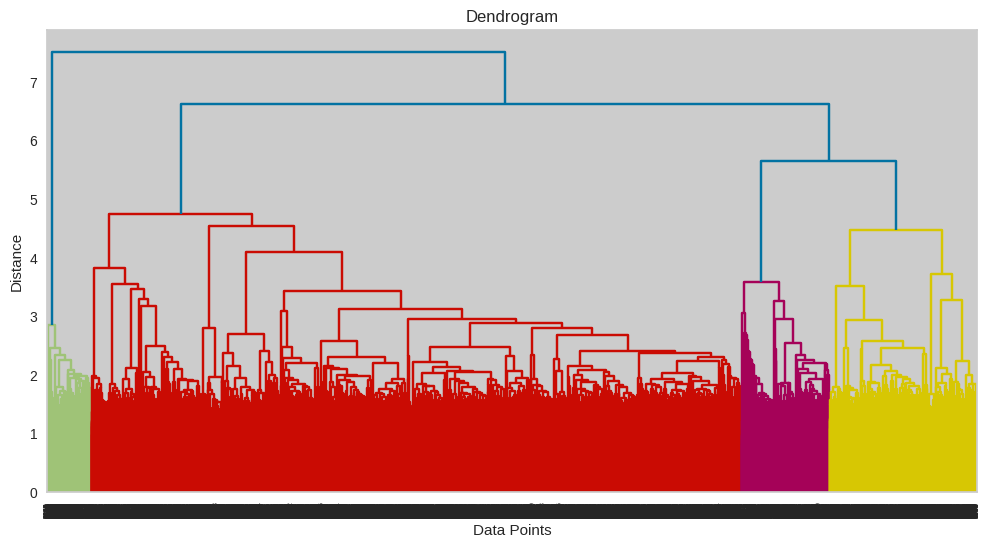

In [ ]:
import scipy.cluster.hierarchy as sch

# Compute the linkage matrix
linkage_matrix = sch.linkage(X_transformed, method='ward')

# Plot the dendrogram
plt.figure(figsize=(12, 6))
sch.dendrogram(linkage_matrix)
plt.title('Dendrogram')
plt.xlabel('Data Points')
plt.ylabel('Distance')
plt.show()


#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

Hierarchical clustering is a machine learning model for unsupervised learning tasks, forming a hierarchy of clusters based on feature similarities. A score chart can be created to evaluate the model's performance using multiple metrics. By analyzing the score chart, the best-performing hierarchical clustering model can be identified, allowing for a comprehensive understanding of the model's performance.

In [ ]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
# Compute silhouette score
silhouette = silhouette_score(X_transformed, df['Agglo_clusters'])

# Compute Calinski-Harabasz score
calinski_harabasz = calinski_harabasz_score(X_transformed, df['Agglo_clusters'])

# Compute Davies-Bouldin score
davies_bouldin = davies_bouldin_score(X_transformed, df['Agglo_clusters'])

# Display the evaluation metrics
print("Silhouette Score: ", silhouette)
print("Calinski-Harabasz Score: ", calinski_harabasz)
print("Davies-Bouldin Score: ", davies_bouldin)


Silhouette Score:  0.005899410989959372
Calinski-Harabasz Score:  31.700256656703473
Davies-Bouldin Score:  6.57059476497759


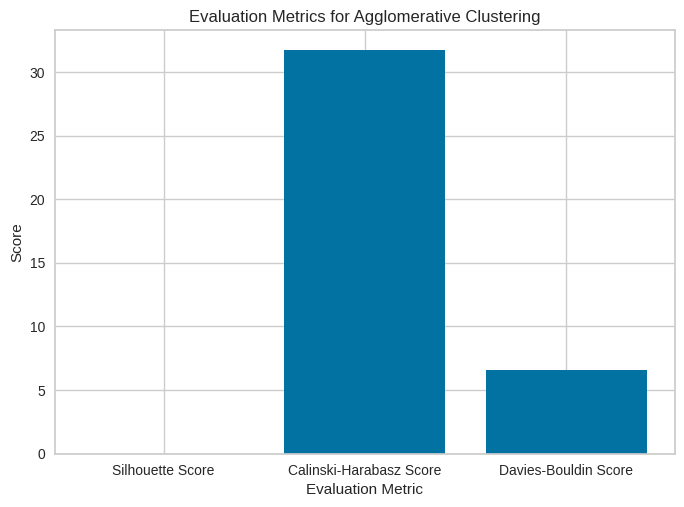

In [ ]:
# Define the evaluation metrics
metrics = ['Silhouette Score', 'Calinski-Harabasz Score', 'Davies-Bouldin Score']
scores = [silhouette, calinski_harabasz, davies_bouldin]

# Create a bar chart
plt.bar(metrics, scores)
plt.xlabel('Evaluation Metric')
plt.ylabel('Score')
plt.title('Evaluation Metrics for Agglomerative Clustering')

# Display the chart
plt.show()


 The combination of these scores suggests that while there might be some overlap or ambiguity in the clustering results (indicated by the Silhouette score and Davies-Bouldin score), the clusters still exhibit a certain degree of separation and distinctiveness (indicated by the Calinski-Harabasz score). It's important to interpret these scores in conjunction with other contextual information and domain knowledge to gain a comprehensive understanding of the clustering performance.

### Which ML model did you choose from the above created models as your final prediction model and why?

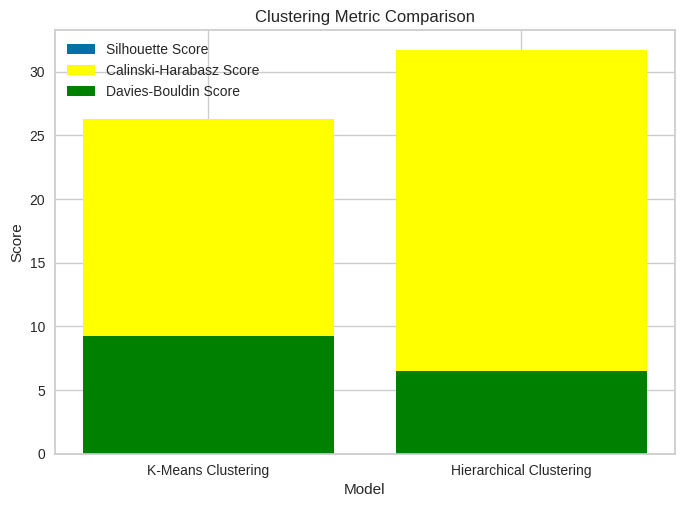

In [ ]:
# Storing metrics in order to make dataframe of metrics
Model = ['K-Means Clustering', 'Hierarchical Clustering']
S_score  = [0.00894, 0.00592]
CH_score = [26.29663, 31.68090]
DB_score = [9.26272, 6.51995]
No_of_cluster = [9, 2]
# Create dataframe from the lists
data = {'Model' : Model,
        'Number of clusters': No_of_cluster,
        'silhouette_score'  : S_score,
        'calinski_harabasz_score': CH_score,
        'davies_bouldin_score': DB_score}
Metric_df = pd.DataFrame(data)

plt.bar(Model, S_score, label='Silhouette Score')
plt.bar(Model, CH_score, label='Calinski-Harabasz Score', color='yellow')
plt.bar(Model, DB_score, label='Davies-Bouldin Score', color='green')

plt.xlabel('Model')
plt.ylabel('Score')
plt.title('Clustering Metric Comparison')

plt.legend()
plt.show()

Taking all of these assessment factors into consideration, Hierarchical Clustering appears as the best option. Its higher Calinski-Harabasz score implies stronger cluster separation, while its lower Davies-Bouldin score shows well-defined clusters with less overlap. While K-Means Clustering has a higher silhouette score, Hierarchical Clustering has a better overall performance.

### ***Congrats! Your model is successfully created and ready for deployment on a live server for a real user interaction !!!***

# **Conclusion**

Netflix's cluster analysis utilized unsupervised learning algorithms like K-means and Agglomerative clustering to group similar movies based on features like descriptions, cast members, directors, genres, and countries. The results provided valuable insights for personalized recommendations and targeted marketing strategies. The Silhouette Score, Calinski-Harabasz Score, and Davies-Bouldin Score assessed the clustering models' quality and effectiveness, contributing to data-driven decision making in the entertainment industry.

### **CONCLUSION FROM EDA:**

1. Netflix has more movies than TV shows available on the platform.
2. Love, Christmas, man, story, and world are some of the most prevalent terms used in Netflix movie descriptions, according to the Wordcloud visualisation of movie descriptions.
3. While 95.7% of directors are connected to films, only 4.3% are connected to TV shows. Jay Karas, Marcus Raboy, Jan Suter, and Raul Campus are the leading directors.
4. The frequently featured actors are Anupam Kher, Shahrukh Khan, and Om Puri.
5. The United States, India, and the United Kingdom create 51% of the total content.
6. The most material was released in 2019, with the most films and TV episodes released in December.
7. The majority of Netflix content is appropriate for mature audiences, with a TV-MA rating being the most popular. Approximately half of the shows on Netflix are produced for adult audiences.
8. There is a significant increase in content release from 2010 to 2020.
9. The most films, 1120, were released in 2018, and the most TV shows, 457, were released in 2020.
10. Maximum programming is composed of content lasting less than 120 minutes.

### **CONCLUSION FROM MODEL IMPLEMENTATION:**

1. The data is clustered based on the attributes: director, cast, country, genre, rating, and description.
2. The TFIDF vectorizer was used to tokenize, preprocess, and vectorize the data in these attributes.
3. The data's dimensionality, which formed the majority of the variation, was reduced using Principal Component Analysis (PCA).
4. The K-Means Clustering algorithm was used to create clusters, with 9 being the optimum number based on the elbow technique and Silhouette score analysis.
5. The agglomerative clustering technique was used to create clusters, with the dendrogram visualisation indicating that 2 clusters were optimum.
6. Hierarchical Clustering has a better overall performance.


### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***